# **Assignment 2: Data Analysis of EU procurement networks**

Author: Kai Foerster <br>
ID: 214288 <br>
Date: 9 November 2023

# Disclaimer and References:
This work would not have been possible without EU procurement data provided under: https://networks.skewed.de/net/eu_procurements_alt. <br>
Much of the interpretation is based on work presented in: Wachs, J., Fazekas, M. & Kertész, J. Corruption risk in contracting markets: a network science perspective. Int J Data Sci Anal 12, 45–60 (2021). https://doi.org/10.1007/s41060-019-00204-1 <br>
Finally, this work would not be possible without intense discussion between classmates and through the help of online forums, and OpenAI's ChatGPT which has helped in debugging and describing the code.

# Introduction

In this project, I examine the networks of public procurement contracts across various EU nations, drawing on a portion of the dataset used by Wachs, Fazekas, and Kertész in their 2020 study, "Corruption risk in contracting markets: a network science perspective." The complete eu_procurements_alt dataset encompasses 234 networks, each depicting the yearly procurement activities of 26 European countries over the period from 2008 to 2016. This information originates from the Tenders Electronic Daily (TED), which is the EU's official portal for public procurement. Each network consists of issuers and winners of procurement contracts.  Each of these networks is structured as a bipartite graph, with edges symbolizing the contract awards between issuers and winners. To proceed with our analysis, additional steps will be taken to properly handle the bipartite structure inherent in these networks.


# Motivation and choice of countries and years

While the comprehensive dataset includes data for 26 EU countries, this analysis narrows its focus to four specific countries: **Austria**, **Cyprus**, **Denmark**, and **Bulgaria**. The rationale for this selection is twofold: Firstly, these countries have comparatively smaller network sizes, which simplifies the computational process. Secondly, by analyzing only the years **2008** and **2016**, we cover a significant span of time while also reducing complexity. This approach strikes a balance between computational feasibility and the breadth of the analysis.

In the context of corruption indicators, like the average single bidding rate used by Wachs, Fazekas, and Kertész, the chosen countries offer a diverse range of network behaviors. Cyprus and Bulgaria are included for their higher perceived levels of corruption, potentially offering insights into how such traits manifest in network structure. Conversely, Denmark, often considered a standard for low corruption levels, and Austria, which sits in the middle, provide contrasting examples. The selection aims to yield a better understanding of network properties in relation to different corruption levels, with the possibility of extending the analysis to additional countries and years for a more comprehensive study in the future.

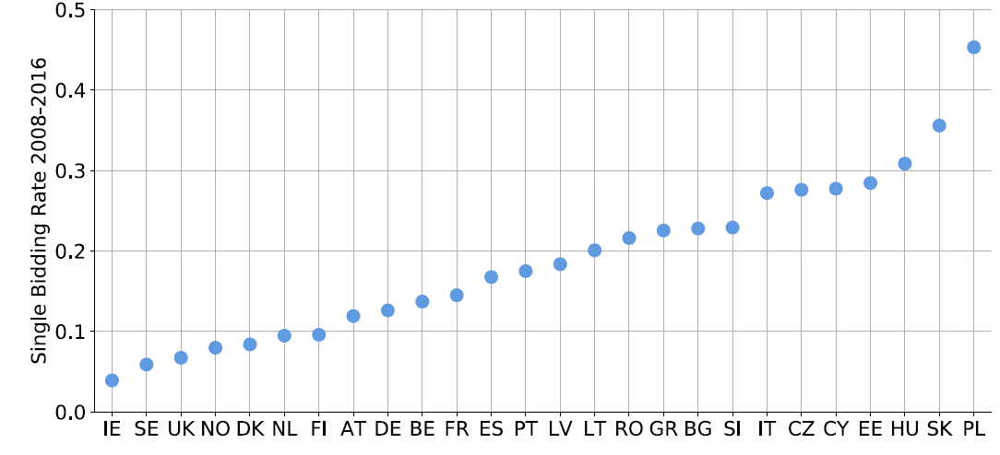

Figure 1: Single-bidding rates on procurement contracts on TED, 2008–2016 by country, retrieved from Wachs et al. (2021)

# Importing and manipulating the data for further analysis
Note on running this .ipynb file: This file is running using graph-tool installed on the wsl:Ubuntu (Linux for Windows). Before running this file you will need to install graph-tool to your PC (different methods for Windows and Mac) or configure graph-tool on Google Colab. Below you find commented out, code to configure graph-tool in Google Colab. Instructions on how to install graph-tool on Windows or Mac can be found on the graph-tool website: https://graph-tool.skewed.de/static/doc/index.html#installing-graph-tool (Last accessed: 8 November 2023)

In [1]:
# %%capture
# !echo "deb http://downloads.skewed.de/apt jammy main" >> /etc/apt/sources.list
# !apt-key adv --keyserver keyserver.ubuntu.com --recv-key 612DEFB798507F25
# !apt-get update
# !apt-get install python3-graph-tool python3-matplotlib python3-cairo

In [2]:
# %%capture
# !apt purge python3-cairo
# !apt install libcairo2-dev pkg-config python3-dev
# !pip install --force-reinstall pycairo
# !pip install zstandard

In [2]:
# Import graph tool libraries
import graph_tool.all as gt
from graph_tool.all import Graph

/usr/lib/python3/dist-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.17.3 and <1.25.0 is required for this version of SciPy (detected version 1.26.1
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [3]:
# Import other libraries
import matplotlib.pyplot as plt
import numpy as np
import matplotlib
import os
import matplotlib.image as mpimg
import geopandas as gpd
import matplotlib.cm as cm
import matplotlib.colors as colors
import networkx as nx
from networkx.algorithms import bipartite

In [4]:
# Import data on eu procurement contracts from Netzschleuder using graph tool and save the networks in the dictionary datasets

# Select the countries and years you want to retrieve
countries_years = [
    ('AT', '2008'),
    ('BG', '2008'),
    ('CY', '2008'),
    ('DK', '2008'),
    ('AT', '2016'),
    ('BG', '2016'),
    ('CY', '2016'),
    ('DK', '2016')
]

# Create a dictionary to hold your data
datasets = {}

# Iterate over each country/year pair and retrieve the corresponding dataset
for country_code, year in countries_years:
    dataset_name = f"{country_code}_{year}"  # This will be the key, e.g., 'AT_2016'
    full_dataset_name = f"eu_procurements_alt/{dataset_name}"  # This is the full path used to retrieve the dataset from Netzschleuder
    datasets[dataset_name] = gt.collection.ns[full_dataset_name]

# Now we have a dictionary where the keys are 'AT_2016', 'CY_2008', etc., and the values are the data you've retrieved

In [5]:
# Convert the graph-tool networks stored in datasets to networkx networks stored in datasets_nx
# Note: Given that graph-tool and networkx are different libraries, we need to convert the graph-tool networks to networkx networks
#       in order to use networkx functions. We need the networkx function bipartite.projected_graph() to compute the issuer and winner
#       projections. We also need the networkx function bipartite.is_bipartite() to check whether a graph is bipartite. Doing this
#       conversion is a bit cumbersome, but it's the only way to use networkx functions on graph-tool graphs. The equivalent functions
#       in graph-tool do not exist or must be implemented manually.

# Initialize the new dictionary to hold networkx datasets, saved in datasets_nx
datasets_nx = {}

for dataset_name, g_tool_graph in datasets.items():
    # Initialize a new networkx graph for the current dataset
    G_nx = nx.Graph()

    # Add vertices and their attributes to the networkx graph
    for v in g_tool_graph.vertices():
        # Here, 'v_prop' is a dictionary of the vertex properties
        v_prop = {prop: g_tool_graph.vp[prop][v] for prop in g_tool_graph.vertex_properties.keys()}
        G_nx.add_node(v, **v_prop)

    # Add edges and their attributes to the networkx graph
    for e in g_tool_graph.edges():
        # Here, 'e_prop' is a dictionary of the edge properties
        e_prop = {prop: g_tool_graph.ep[prop][e] for prop in g_tool_graph.edge_properties.keys()}
        G_nx.add_edge(e.source(), e.target(), **e_prop)

    # Add the networkx graph to the new datasets dictionary
    datasets_nx[dataset_name] = G_nx

# Now `datasets_nx` contains all the networkx graphs corresponding to the graph-tool graphs

In [6]:
# Create the issuer and winner projections using networkx functions. Then convert to projections in networkx format
# back to graph-tool format and save the networks in the dictionary datasets_prj. In the dictionary datasets_prj,
# the keys are the names of the projections and the values are the projections themselves. The keys are named after
# country name, year, and projection type (issuer or winner). For example, the key 'AT_2016_issuer' corresponds to
# the issuer projection of the network for Austria in 2016.


datasets_prj = {}  # This dictionary will store the projections

# Function to create and return both issuer and winner projections from the eu procurement bipartite graphs
def create_projections(G):
    issuers_set = {n for n, d in G.nodes(data=True) if d['label'].endswith('_i')}
    winners_set = {n for n, d in G.nodes(data=True) if d['label'].endswith('_w')}

    # Create the bipartite projections
    issuer_projection = bipartite.projected_graph(G, issuers_set)
    winner_projection = bipartite.projected_graph(G, winners_set)

    return issuer_projection, winner_projection

# Function to convert a networkx graph to a graph-tool graph
def convert_networkx_to_graphtool(G_nx, name_description):
    G_gt = Graph(directed=False)
    pos_property = G_gt.new_vertex_property("vector<double>")
    label_property = G_gt.new_vertex_property("string")
    vertex_map = {node: G_gt.add_vertex() for node in G_nx}
    for node, data in G_nx.nodes(data=True):
        v = vertex_map[node]
        pos_property[v] = data.get('_pos', [0.0, 0.0])
        label_property[v] = data['label']
    for u, v in G_nx.edges():
        G_gt.add_edge(vertex_map[u], vertex_map[v])

    # Set the graph name and description properties
    G_gt.graph_properties["name"] = G_gt.new_graph_property("string", name_description[0])
    G_gt.graph_properties["description"] = G_gt.new_graph_property("string", name_description[1])

    return G_gt, pos_property, label_property

# Loop over each network in datasets_nx
for dataset_key, G_nx in datasets_nx.items():
    # Split the key to get country and year
    country, year = dataset_key.split('_')

    # Create the projections
    issuer_projection, winner_projection = create_projections(G_nx)

    # Convert projections to graph-tool format
    name_description = (f"eu_procurements_alt ({country}_{year}_issuer)",
                        "Issuer projection of the bipartite graph")
    datasets_prj[f"{country}_{year}_issuer"], _, _ = convert_networkx_to_graphtool(issuer_projection, name_description)

    name_description = (f"eu_procurements_alt ({country}_{year}_winner)",
                        "Winner projection of the bipartite graph")
    datasets_prj[f"{country}_{year}_winner"], _, _ = convert_networkx_to_graphtool(winner_projection, name_description)


In [7]:
# Function to draw a graph-tool graph using the edge properties 'count' and 'pctSingleBid'. Here, 'count' is the number of contracts
# between two nodes and 'pctSingleBid' is the percentage of contracts between two nodes that were single-bid contracts. 'count' is used
# as weight for the edge pen width and 'pctSingleBid' is used to color the edges where the edges become more red as the percentage of
# single-bid contracts increases, i.e. goes from 0 to 1. The vertex color is determined by the vertex type, i.e. 'issuer' or 'winner'.
# The vertex type is determined by the vertex label, which ends with '_i' for issuers and '_w' for winners. The vertex outline is black
# for all vertices. The vertex pen width is set to 1.2. The function returns a dictionary with the drawing parameters.

def draw_weighted_colored_graph(u, edge_color_property_name='edge_color'):
    """
    Prepares edge color, pen width, and vertex color based on 'count', 'pctSingleBid',
    and vertex type ('issuer' or 'winner').
    Designed to be used within gt.graph_draw.
    :param u: The graph for which the drawing parameters are being prepared.
    :param edge_color_property_name: The name to be assigned to the new edge color property.
    :return: A dictionary with the edge_color, edge_pen_width, vertex_fill_color, and vertex_outline properties.
    """
    # Retrieve the 'count' and 'pctSingleBid' edge properties
    edge_count = u.ep["count"]
    edge_pctSingleBid = u.ep["pctSingleBid"]

    # Create a new edge property for the matplotlib color mapping
    edge_color = u.new_edge_property('vector<double>')
    u.ep[edge_color_property_name] = edge_color

    # Create color maps and normalization instance for edges
    cmap = plt.get_cmap('coolwarm')
    norm = colors.Normalize(vmin=0, vmax=1)  # 'pctSingleBid' is between 0 and 1

    # Assign colors to edges based on 'pctSingleBid' values
    for e in u.edges():
        normalized_value = norm(edge_pctSingleBid[e])
        edge_color[e] = cmap(normalized_value)

    # Prepare vertex color properties
    vertex_fill_color = u.new_vertex_property('vector<double>')
    vertex_outline = u.new_vertex_property('vector<double>')  # For the boundary

    # Check the vertex 'label' property and assign colors accordingly
    for v in u.vertices():
        label = u.vp.label[v]
        if label.endswith("_i"):  # Check if the vertex label ends with '_i'
            vertex_fill_color[v] = [0.5, 0.5, 0.5, 1]  # Gray for issuers
        elif label.endswith("_w"):  # Check if the vertex label ends with '_w'
            vertex_fill_color[v] = [1, 1, 1, 1]  # White for winners
        vertex_outline[v] = [0, 0, 0, 1]  # Black outline for all vertices

    # Prepare the dictionary with drawing parameters
    drawing_parameters = {
        'edge_color': edge_color,
        'edge_pen_width': gt.prop_to_size(edge_count, mi=0.5, ma=25, power=1),
        'vertex_fill_color': vertex_fill_color,
        'vertex_color': vertex_outline,  # This is for the boundary
        'vertex_pen_width': 1.2  # Adjust the pen width as needed
    }

    return drawing_parameters


# Overall network properties

## Basic description of the networks

Here we use Austria in 2008 as example. The below command tells us that the EU procurement network for Austria in 2008 is an undirected graph with 2271 vertices and 2324 edges. The information that there are two internal vertex and edge properties and five internal graph properties is further explored below

In [7]:
print(datasets['AT_2008'])

<Graph object, undirected, with 2271 vertices and 2324 edges, 2 internal vertex properties, 2 internal edge properties, 5 internal graph properties, at 0x7fe92bf1fe20>


The below code gives us five graph properties: The name of the graph which corresponds to the EU country and year recorded in the graph; A description of the eu procurement network project more generally; A suggestion on how to cite the network dataset; A URL under which the data can be retrieved; and a number of tags which suggest topics that the network project belongs to. <br>

The code also gives us two vertex properties: The _pos property record a positing coordinate in the spatial space where the vertex could be located when visualising the graph. I will use this property later on to visulalise the graph. The label property gives us an ID code for the vertex, and "_i" for issuer nodes and "_w" for winner nodes. That is, we have a bipartite network, where issuer are connected with winners when they have a procurement contract. Throughout the analysis we account for the fact that we are working with a bipartite network! <br>

The code also gives us two edge properties: The count property ere tells us the number of contracts between issuer and winner in a given year in a given coutnry. The pctSingleBid property tells us the percentage of contracts between the issuer and the winner that were single-bid contracts. Here single-bid contracts are used as a proxy for corruption risk. While we protray this corruption riska nd the number of contract between issuers and winners in the network visualisations below, I deem that it is beyond the scope of this assignment to infer anything about corruption from the network analysis. Instead, I will use terminology from graph theory to describe the networks more theoretically, without contextualising.

In [8]:
datasets['AT_2008'].list_properties()

name             (graph)   (type: string, val: eu_procurements_alt (AT_2008))
description      (graph)   (type: string, val: These 234 networks represent the
                                               annual national public
                                               procurement markets of 26
                                               European countries from
                                               2008-2016, inclusive. Data is
                                               sourced from Tenders Electronic
                                               Daily (TED), the official
                                               procurement portal of the
                                               European Union.  Nodes with the
                                               suffix "_i" are issuers
                                               (sometimes referred to as
                                               buyers) of public contracts, for
                       

## Degree distribution for networks

The image contains a series of graphs that represent the degree distribution of a bipartite European procurement network for four different countries, with data from the years 2008 and 2016. Each row of graphs corresponds to a single country, labeled as AT (Austria), BG (Bulgaria), CY (Cyprus), and DK (Denmark), with the 2008 data on the top row and the 2016 data on the bottom row. <br>

Each graph has a log-log scale, showing the frequency NP(k) of the degree (k) within the procurement network. Error bars are present on the graphs, indicating the variance or uncertainty in the degree distribution measurements. <br>

A quick visual assessment suggests that the degree distributions follow a power-law or scale-free distribution, which is common in network science and indicates that a few nodes have many connections (contracts), while most nodes have few. The graphs for 2008 and 2016 for each country appear to show a similar distribution shape, which may imply that the overall network structure hasn't drastically changed between these years, but without further analysis, it's difficult to make any definitive conclusions about trends or differences. <br>

The absence of in-degrees is explained by the fact that this is a undirected network, and hence in-degrees are not defined and out-degrees represent the degree k in the undirected graph.

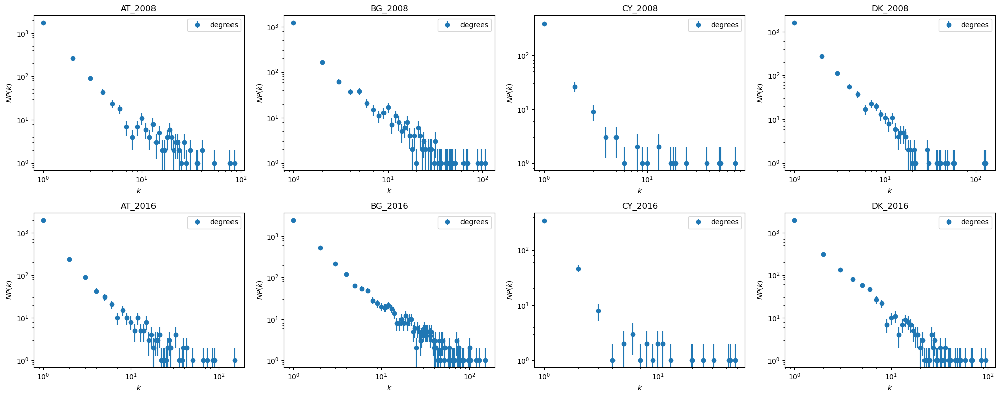

In [10]:
# Determine the layout of the subplots
cols = 4
rows = int(np.ceil(len(datasets) / float(cols)))

# Create a figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))
plt.subplots_adjust(wspace=0.4, hspace=0.6)

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each dataset and create plots
for i, (dataset_key, g) in enumerate(datasets.items()):
    ax = axes[i]

    hist = gt.vertex_hist(g, "out")

    y = hist[0]
    err = np.sqrt(hist[0])

    ax.errorbar(hist[1][:-1], y, fmt="o", yerr=err, label="degrees")

    # Plotting a green line representing the power law
    # Fit a power law to the 'in' degree distribution
    # Select the range for fitting the power law (e.g., degrees from 1 to the maximum degree)
    # This range can be adjusted based on your actual data
    # fit_min = 1
    # fit_max = max(out_hist[1])

    # # Extract the degree values and corresponding probabilities
    # fit_mask = (out_hist[1][:-1] >= fit_min) & (out_hist[1][:-1] <= fit_max)
    # x_fit = out_hist[1][:-1][fit_mask]
    # y_fit = y_out[fit_mask]

    # # Perform the linear fit on the log-transformed data
    # log_x_fit = np.log(x_fit)
    # log_y_fit = np.log(y_fit)
    # slope, intercept = np.polyfit(log_x_fit, log_y_fit, 1)

    # # Generate the fitted line for plotting
    # x_line = np.linspace(fit_min, fit_max, 1000)
    # y_line = np.exp(intercept) * x_line ** slope

    # # Plot the fitted power-law line
    # ax.plot(x_line, y_line, color='green', label='Power law')

    ax.set_yscale("log")
    ax.set_xscale("log")

    ax.set_xlabel("$k$")
    ax.set_ylabel("$NP(k)$")
    ax.set_title(dataset_key)
    ax.legend()

# Hide any unused subplots if the number of plots isn't a perfect grid
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


## Degree distribution for issuer and winner network projections

These graphs are organized in pairs for each country and year, with the left graph in each pair representing the 'issuer' projection and the right graph representing the 'winner' projection. The graphs maintain a log-log scale for the degree distributions, similar to the previous set of graphs, but here the x-axis for 'issuers' in the Cyprus is scaled differently, most likely due to the small network size. <br>

In comparison to the degree distribution of the entire networks, we can note the following: <br>

Degree Distribution Shape: Most 'issuer' and 'winner' projections seem to follow a power-law distribution, indicating that both the issuing and winning of contracts are concentrated in the hands of a few entities. The exceptinon is the issuer projection for Cyprus. Here there seem to be very few nodes and those nodes are not distributed according to a power law. <br>

Issuer vs. Winner projections: When looking more closely at the difference between the degree distribution shapes of the 'issuer' and 'winner' network projections, one can notice that the 'issuer' projections tend to have a steeper slope, which might suggest that a fewer issuers give out more contracts, while for the 'winner' projections one observes a more even distribution of degrees. Some 'winner' projections are characterised by a structural break in the degree distributions: Up to a certain threshold of degrees, there are about equally many nodes of any degree, then the number of nodes for very high degree node drops suddenly and stabilises at a low level. This could mean, that there is a core of winners that often get procurement contracts, and a subcore of other companies who win contracts less frequently.<br>

Temporal Comparison: Comparing the 2008 network projections to the 2016 projections for each country could provide insights into how the procurement network's structure has evolved over time. If the slope of the line in the log-log plots changes significantly from 2008 to 2016, it would suggest that the distribution of contracts (either from the issuer or winner perspective) has changed. However, visually speaking one cannot see any significant differences between the 2008 and 2016 graphs.<br>

Error Bars: Error bars in these graphs appear to be more significant in some 'winner' graphs compared to the 'issuer' ones, indicating more variability or less certainty in the winner data points. 

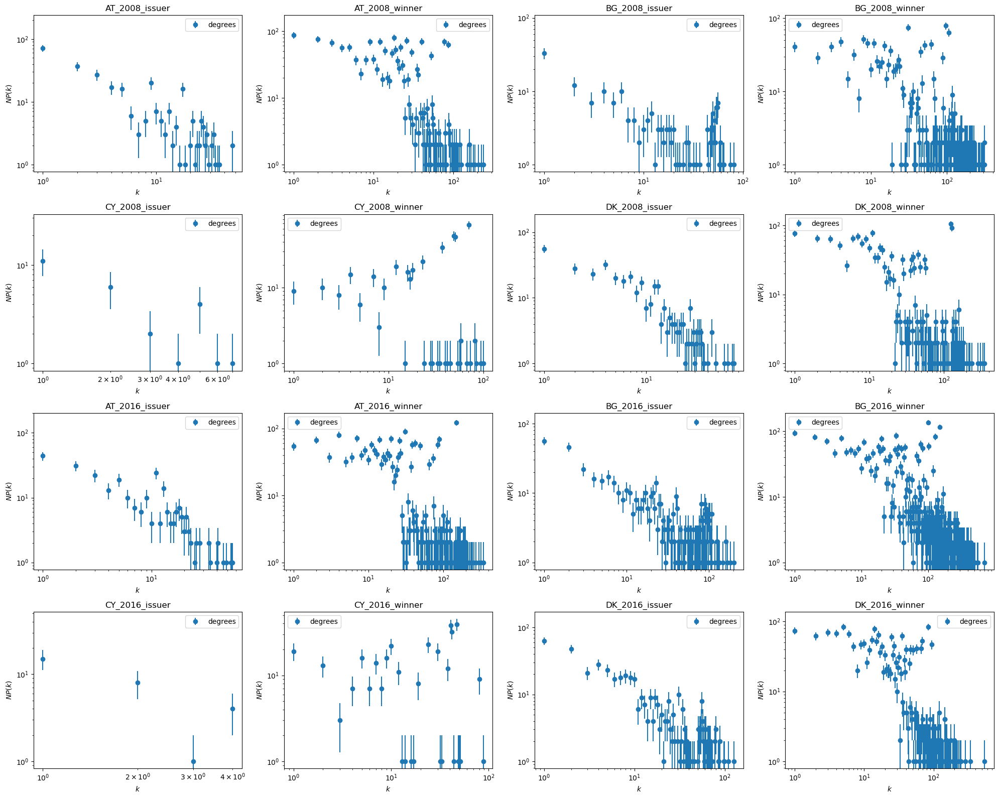

In [11]:
# Determine the layout of the subplots 
cols = 4
rows = int(np.ceil(len(datasets_prj) / float(cols)))

# Create a figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))
plt.subplots_adjust(wspace=0.4, hspace=0.6)

# Flatten the axes array for easy iteration, in case of a 2D axes array
axes = axes.flatten()

# Loop through each dataset and create plots
for i, (dataset_key, g) in enumerate(datasets_prj.items()):
    ax = axes[i]

    hist = gt.vertex_hist(g, "out")

    y = hist[0]
    err = np.sqrt(hist[0])

    ax.errorbar(hist[1][:-1], y, fmt="o", yerr=err, label="degrees")

    ax.set_yscale("log")
    ax.set_xscale("log")

    ax.set_xlabel("$k$")
    ax.set_ylabel("$NP(k)$")
    ax.set_title(dataset_key)
    ax.legend()

# Hide any unused subplots if the number of plots isn't a perfect grid
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

## Layouts

The three images below depict a series of network graphs, each representing the procurement networks of four EU countries across two time points, 2008 and 2016. These networks are visualized using a Scalable Force Directed Placement (FDP) layout (first image), a Fruchtermann-Reingold layour (second image) and using the stored location properties of the network (third image) which are attained by specifying accesing the _pos property of the vertices. In these visualizations, nodes represent entities, and edges represent the relationships between them.  <br>

In each network:<br>
- Gray nodes are issuers of contracts. <br>
- White nodes are winners of contracts. <br>
- The weight of the edges (thickness) indicates the count of contracts between the issuers and winners. <br>
- The color of the edges represents the share of single-bid contracts among these connections; the redder an edge, the higher the proportion of single-bid contracts. <br>

As argued for in Wachs et al. (2021), single-bid contracts are used as a proxy for measuring corruption risk because they might indicate a lack of competition in the bidding process, potentially due to favoritism or pre-arranged outcomes. <br>

From the visualizations, one can observe that Austria, Bulgaria and Denkmark have more dense networks than Cyprus, suggesting that these countries have a more developed procurement market / engage in more tendering activity. Furthermore, there are some countries which seem to have a more centralized network with a few nodes having a large number of connections (possibly indicating major contractors or issuers), such as Denmark and Austria in 2016. In contrast, others display a more dispersed network, like Cyprus, suggesting a more distributed procurement system with many participants. In Bulgaria, one can observe two big clusters in 2008, which seem to have grown together by 2016. <br>

Observing the colouring and thickness of edges, one can see that most edges are thin, suggesting that it is rather rare that one issuer has many different procurment contracts with a winner. A look at the colours of the edges suggests, that a majority of edges are blue, i.e. contracts that were won in a competition against more than one other bidder - which suggests low corruption risk. However, some clustering of red edges is observable throughout the Bulgarian network in both 2008 and 2016. In the other countries, red edges occur less frequently and are clustered towards the periphery of the network (see for example Austria in 2016). It's important to note that while such visualizations can provide insights into the structure and dynamics of procurement networks, they are not definitive indicators of corruption, and further analysis can shed more light into the mechanism and structures of corruption. 

### Representation of the networks in spring / FDP (Scalable Force Directed Placement) layout

In [11]:
# Ensure the output directory exists
output_dir = "fdp_layout"
os.makedirs(output_dir, exist_ok=True)

In [12]:
# Loop through each dataset and save the graph as an image
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u)
    output_path = os.path.join(output_dir, f"{dataset_key}.png")
    drawing_parameters = draw_weighted_colored_graph(u)
    gt.graph_draw(u, pos, output=output_path, **drawing_parameters)


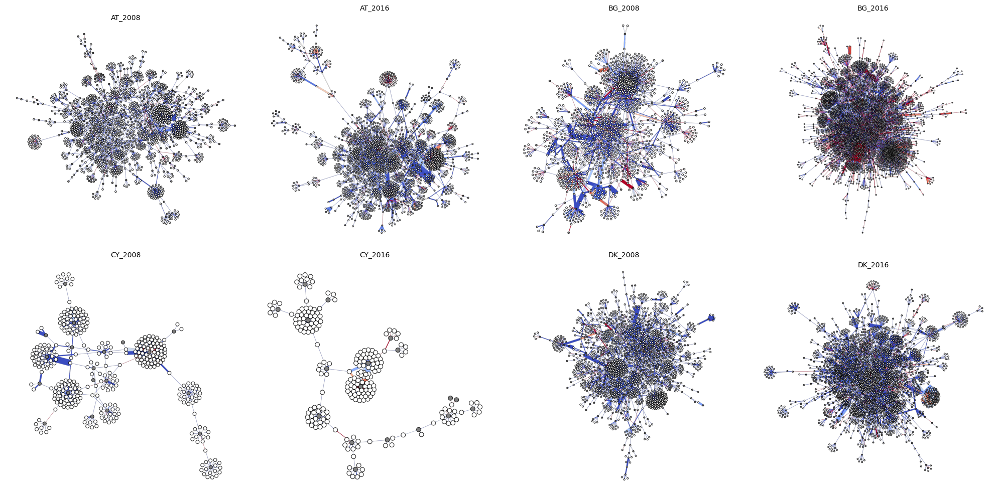

In [13]:
# Get the list of all saved images
image_files = sorted([os.path.join(output_dir, f) for f in os.listdir(output_dir) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files) / float(cols)))

# Create the figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration, in case of a 2D axes array
axes = axes.flatten()

# Loop through each image file and add it to the subplot
for i, image_file in enumerate(image_files):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Turn off the axis
    # Set the title for the subplot using the filename
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots if the number of plots isn't a perfect grid
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust layout and display
plt.tight_layout()
plt.show()


### Representation of the networks in Fruchterman Reingold layout

In [14]:
# Ensure the output directory exists for Fruchterman-Reingold layouts
output_dir_fr = "fruchterman_reingold_layout"
os.makedirs(output_dir_fr, exist_ok=True)

In [15]:
# Loop through each dataset and save the graph with Fruchterman-Reingold layout as an image
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)
    pos_fr = gt.fruchterman_reingold_layout(u, n_iter=100)  # Set the number of iterations if needed
    output_path = os.path.join(output_dir_fr, f"{dataset_key}.png")
    drawing_parameters = draw_weighted_colored_graph(u)
    gt.graph_draw(u, pos_fr, output=output_path, **drawing_parameters)


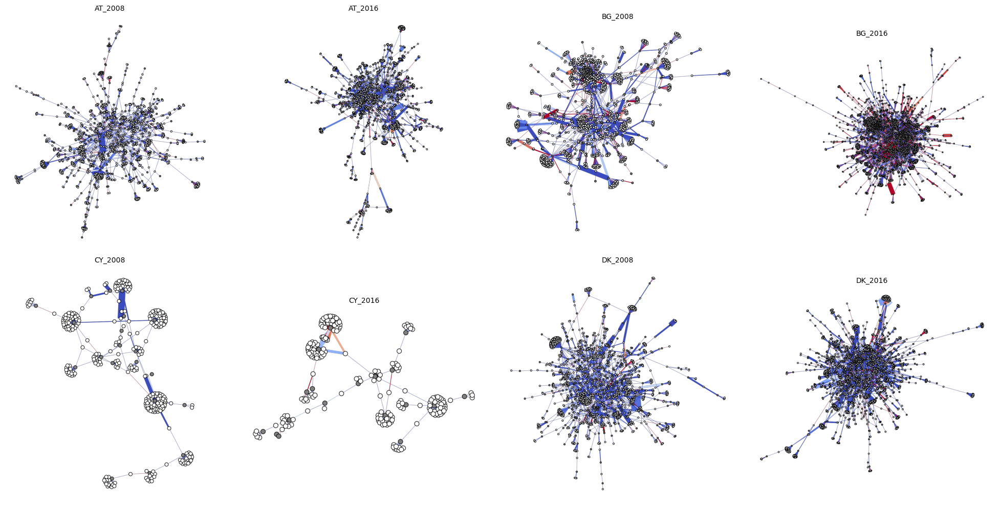

In [16]:
# Get the list of all saved images for Fruchterman-Reingold layouts
image_files_fr = sorted([os.path.join(output_dir_fr, f) for f in os.listdir(output_dir_fr) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_fr) / float(cols)))

# Create the figure with subplots for Fruchterman-Reingold layouts
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for Fruchterman-Reingold layouts and add it to the subplot
for i, image_file in enumerate(image_files_fr):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


###  Representation of the networks using pre-determined and stored as a vertex property

In [17]:
# Ensure the output directory exists for the stored positions
output_dir_vp = "predefined_layout"
os.makedirs(output_dir_vp, exist_ok=True)

In [18]:
# Loop through each dataset and save the graph using the stored positions as an image
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)
    output_path = os.path.join(output_dir_vp, f"{dataset_key}.png")
    drawing_parameters = draw_weighted_colored_graph(u)
    gt.graph_draw(u, pos=u.vp["_pos"], output=output_path,**drawing_parameters)


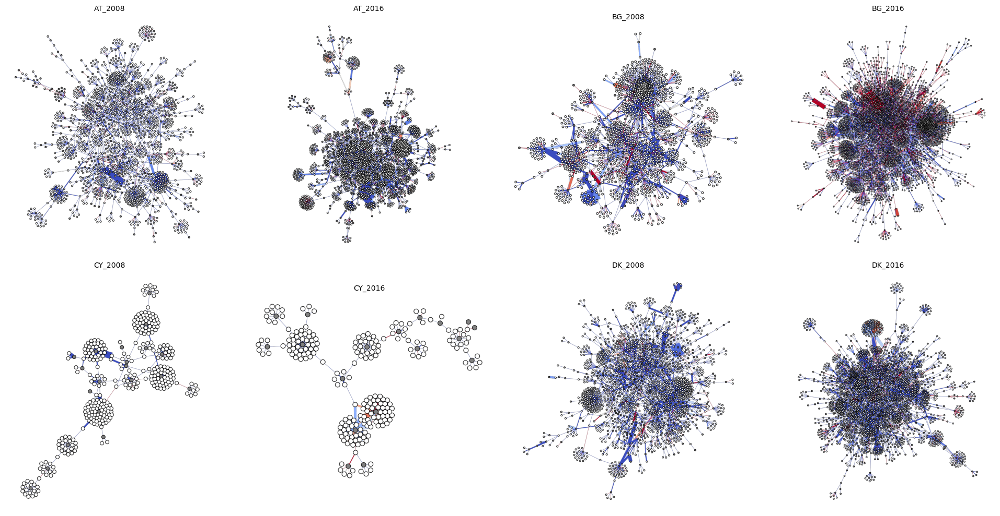

In [19]:
# Get the list of all saved images for the stored positions
image_files_vp = sorted([os.path.join(output_dir_vp, f) for f in os.listdir(output_dir_vp) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_vp) / float(cols)))

# Create the figure with subplots for the stored positions
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for the stored positions and add it to the subplot
for i, image_file in enumerate(image_files_vp):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


## Centrality measures

Gaining a deeper insight into our network necessitates assessing the significance of each node within it. Various centrality metrics offer distinct viewpoints on the notion of "centrality" within the network's structure and can assist us in detecting underlying patterns in the data.

The three images below use three different centrality measures to portray the centrality of nodes. The centrality measures are: page rank (first image), betweeness (second image) and closeness (third image) centrality. Across images and across country-year graphs, one can observe the nodes in the center of the network tend to have a higher measure of centrality. Differences between graphs appear with respect to where nodes with high "centrality" are located.

In Cyprus, where the network is not so dense, we observe that the nodes in the middle of clusters have higher centality. By cross-checking those nodes with the visualisations of the networks using different layouts in the section before, one can notice that the central nodes are often issuers, which are central because they have connections to a number of winners. The centrality of those nodes are driven by the number of companies they have procurement arrangements with. The winners however are seldom connected with other issuers, meaning that the network looks quite decentralised with a number of clusters.

In contrast, in Denmark and Austria (2016) and Bulgaria (2016), one can observe highly centralised network in which the nodes with the higher centrality are located in the middle of the network. There are a few clusters at the periphery, but in contrast to the core, those clusters are far less central and are all connected with the core, suggesting that there exist a network of companies and issuers who are strongly linked with each other.

An intersting middle case between the two extremes is observable in Bulgaria (2008) and to a lesser exten in Austria (2008), where a number of highly centralised hubs are spread across a low number of about five, six clusters in the core. Such as structure might be in line with a network in which issuers and winners are partly centralised in different topical or geographic dimensions, but where the network is not centralised to the extent that a strong core exists.

Note: Decided against running eigenvector centrality because it was too computationally expensive. <br>

### Page rank centrality

In [20]:
# Ensure the output directory exists for the PageRank images
output_pg = "pagerank_images"
os.makedirs(output_pg, exist_ok=True)

In [21]:
# Compute and visualize PageRank for each graph, and save as images
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)

    # Calculate PageRank
    pr = gt.pagerank(u)

    # Save the visualization as an image
    output_path = os.path.join(output_pg, f"{dataset_key}.png")
    gt.graph_draw(u, pos=u.vp["_pos"], vertex_fill_color=pr,
                  vertex_size=gt.prop_to_size(pr, mi=5, ma=15),
                  vorder=pr, vcmap=matplotlib.cm.gist_heat,
                  output=output_path)


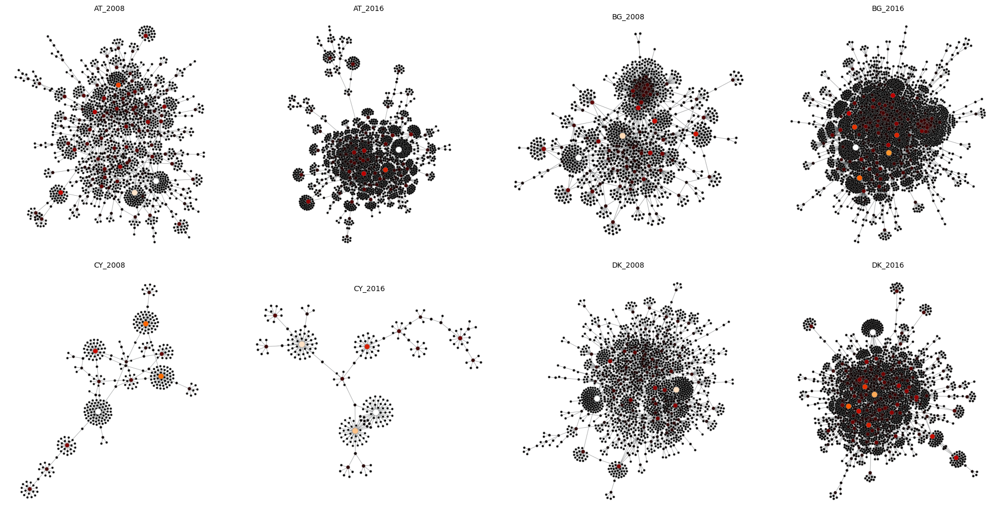

In [22]:
# Get the list of all saved images for PageRank visualizations
image_files_pg = sorted([os.path.join(output_pg, f) for f in os.listdir(output_pg) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_pg) / float(cols)))

# Create the figure with subplots for the PageRank visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for PageRank visualizations and add it to the subplot
for i, image_file in enumerate(image_files_pg):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


### Betweeness centrality

In [23]:
# Ensure the output directory exists for the betweenness images
output_dir_bt = "betweenness_images"
os.makedirs(output_dir_bt, exist_ok=True)


In [24]:
# Compute and visualize betweenness for each graph, and save as images
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)

    # Calculate betweenness
    vp, ep = gt.betweenness(u)

    # Save the visualization as an image
    output_path = os.path.join(output_dir_bt, f"{dataset_key}.png")
    gt.graph_draw(u, pos=u.vp["_pos"], vertex_fill_color=vp,
                  vertex_size=gt.prop_to_size(vp, mi=5, ma=15),
                  edge_pen_width=gt.prop_to_size(ep, mi=0.5, ma=5),
                  vcmap=cm.gist_heat, vorder=vp,
                  output=output_path)


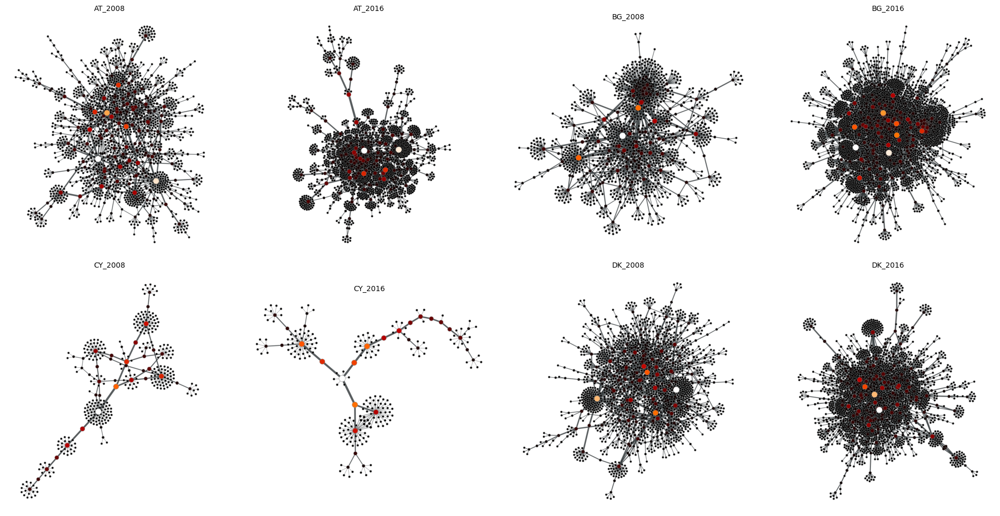

In [25]:
# Get the list of all saved images for betweenness visualizations
image_files_bt = sorted([os.path.join(output_dir_bt, f) for f in os.listdir(output_dir_bt) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_bt) / float(cols)))

# Create the figure with subplots for the betweenness visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for betweenness visualizations and add it to the subplot
for i, image_file in enumerate(image_files_bt):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


### Closeness centrality

In [26]:
# Ensure the output directory exists for the closeness images
output_dir_cl = "closeness_images"
os.makedirs(output_dir_cl, exist_ok=True)

In [27]:
# Compute and visualize closeness for each graph, and save as images
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)

    # Calculate closeness centrality
    c = gt.closeness(u)

    # Save the visualization as an image
    output_path = os.path.join(output_dir_cl, f"{dataset_key}.png")
    gt.graph_draw(u, pos=u.vp["_pos"], vertex_fill_color=c,
                  vertex_size=gt.prop_to_size(c, mi=5, ma=15),
                  vcmap=cm.gist_heat, vorder=c,
                  output=output_path)


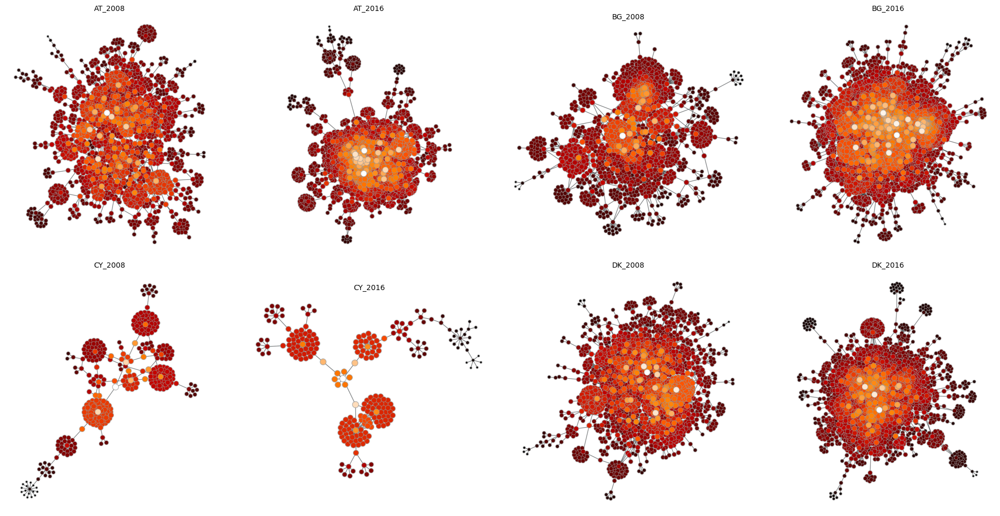

In [28]:
# Get the list of all saved images for closeness visualizations
image_files_cl = sorted([os.path.join(output_dir_cl, f) for f in os.listdir(output_dir_cl) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_cl) / float(cols)))

# Create the figure with subplots for the closeness visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for closeness visualizations and add it to the subplot
for i, image_file in enumerate(image_files_cl):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


## K-core decomposition

The image below shows a visualisation of the k-core decomposition of the respective networks. The k-core decomposition is a method used in network analysis to identify and visualize the hierarchy, clustering and centrality if nodes within a network. The k-core of a graph is a maximal subgraph in which each vertex has at least degree k. <br>

The k-core decomposition brings the points brought forward in the text on centrality further.  For example, the nodes that had high centrality in the images before, tend to have a high k-core in the image below, providing further reassurance that the nodes are central. Furthermore, the community structure mentioned in the text on centrality also takes shape in the k-core decomposition. We can see that Cyprus has a relatively decentralised network with less interlinked clusters, while Denmark, Bulgaria (2016) and Austria (2016) have a strong core with very little or no other clusters. <br>

For both Austria and Denmark we can observe that the nodes with high k-cores have moved further to the centre of the network between 2008 and 2016, suggesting that the procurement market may have become more centralised between these years. In Bulgaria, we can observe a similar phenomena, but also an interesting new phenomena: In both 2008 and 2016 we can see a cluster of nodes with high k-cores next to the core. The similarity of the colouring of the nodes in that cluster between 2008 and 2016 suggests, contrary to what the visualisations of the centrality measuers suggested, that this cluster might have not grown together with the core between 2008 and 2016.

In [29]:
# Ensure the output directory exists for the stored images
output_dir_kcore = "kcore_images"
os.makedirs(output_dir_kcore, exist_ok=True)

In [30]:
# Generate k-core decomposition images for each graph
for dataset_key, g in datasets.items():
    u = gt.extract_largest_component(g, prune=True)
    kcore = gt.kcore_decomposition(u)
    output_path = os.path.join(output_dir_kcore, f"{dataset_key}.png")
    gt.graph_draw(u, vertex_fill_color=kcore, vertex_text=kcore, output=output_path)


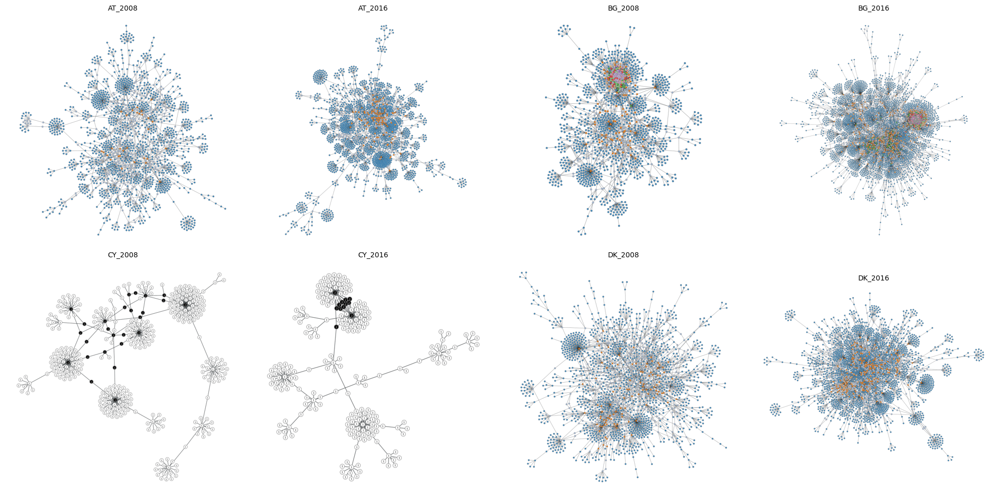

In [31]:
# Get the list of all saved images for the k-core decompositions
image_files_kcore = sorted([os.path.join(output_dir_kcore, f) for f in os.listdir(output_dir_kcore) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_kcore) / float(cols)))

# Create the figure with subplots for the k-core decompositions
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes_flat = axes.flatten()

# Loop through each image file for the k-core decompositions and add it to the subplot
for i, image_file in enumerate(image_files_kcore):
    img = mpimg.imread(image_file)
    axes_flat[i].imshow(img)
    axes_flat[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes_flat[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes_flat)):
    axes_flat[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


# Issuer and winner network projections

## Centrality measures

The visualisation of the issuer and winner projections using different centrality measures provides further details to the network structure we observed across the overall networks. We can observe both similarity and differences between countries and between years for the issuer and winner projections. <br>

In terms of similarities across countries, we can observe more generally that the issuer projections have less nodes than the winner projections, suggesting that issuers engage with a much higher number of winning companies than winning companies engage with different issuers. One can also observe that the winner projections are relatively highly centralised across countries and years. The exception is Cyprus, for which we have already identified, that the procurement market might be significantly smaller and thereby more decentralised than the procurement market of the other three countries. Another interesting observation is that both the issuer and the winner projections of all countries but Cyprus seem to be getting more centralised between 2008 and 2016. <br>

Differences between countries become apparent in the issuer projections. The issuer network in Cyprus is very decentralised which could be explained by the small market size, given there is also a small number of nodes in the projection. In Austria, we can observe that the issuer projection has become more centralised between 2008 and 2016, given the network has shrunk together and the central nodes have moved towards the centre of the network. Interestingly, two clusters that remained in the periphery in 2008, still remain in the periphery in 2016 and have hardly changed size, suggesting the strength of those clusters to perservere the otherwise visible centralisation in the issuer network. In Bulgaria, we can observe the same strong cluster already mentioned before close to the core. It seems then, that the presence of this cluster in the overall network is a result of the clustering in the issuer network. Between 2008 and 2016 the two clusters grow further together. In Denmark, we can observe the phenomena of centralisation in the issuer projection as well. A small difference between Denmark and the other countries however is, that two distinct clusters of issuer nodes become more apparent in 2016 than in 2008, which contrasts the general phenomena of centralisation between the two time periods in other issuer projections.

Note: Decided against running eigenvector centrality because it was too computationally expensive. <br>

### Page rank centrality

In [32]:
# Ensure the output directory exists for the PageRank images
output_dir_pg_pr = "pagerank_images_prj"
os.makedirs(output_dir_pg_pr, exist_ok=True)

In [33]:
# Compute and visualize PageRank for each graph, and save as images
for dataset_key, g in datasets_prj.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u) # we use SFDP layout

    # Calculate PageRank
    pr = gt.pagerank(u)

    # Save the visualization as an image
    output_path = os.path.join(output_dir_pg_pr, f"{dataset_key}.png")
    gt.graph_draw(u, pos=pos, vertex_fill_color=pr,
                  vertex_size=gt.prop_to_size(pr, mi=5, ma=15),
                  vorder=pr, vcmap=matplotlib.cm.gist_heat,
                  output=output_path)

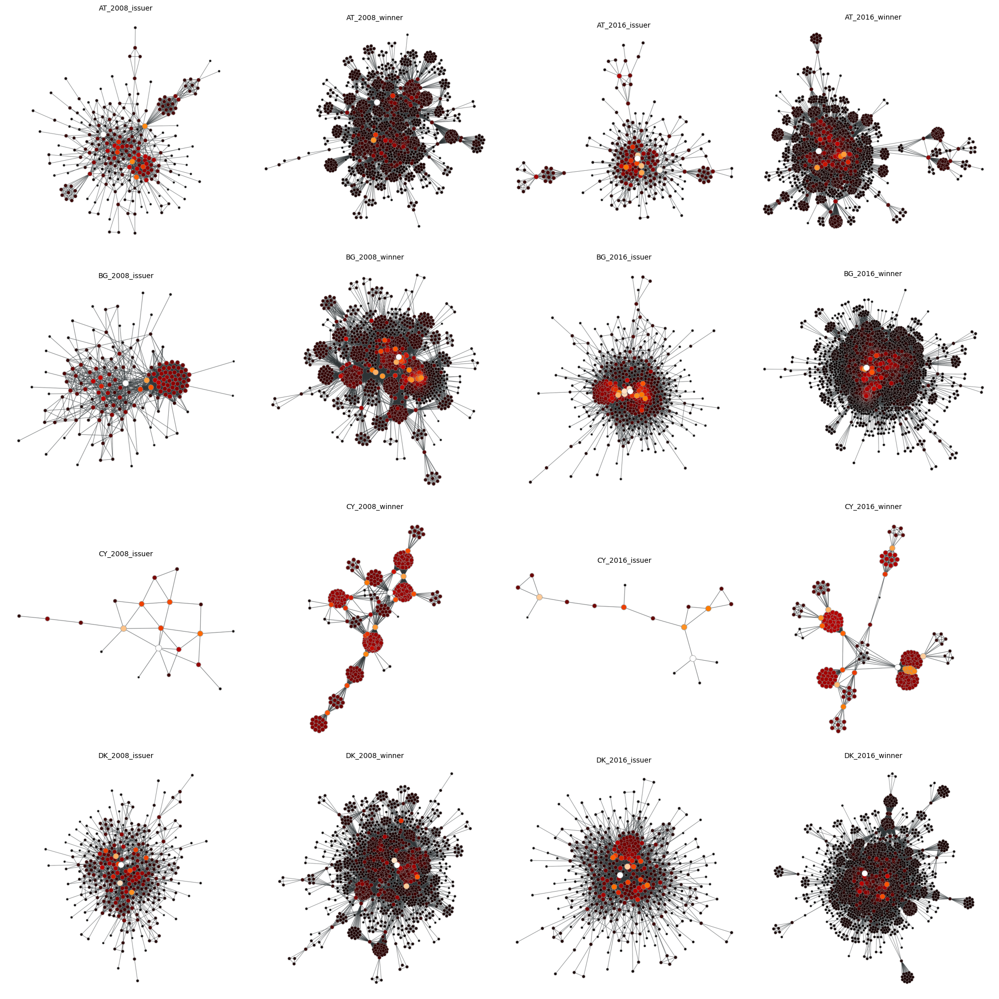

In [34]:
# Get the list of all saved images for PageRank visualizations
image_files_pg_pr = sorted([os.path.join(output_dir_pg_pr, f) for f in os.listdir(output_dir_pg_pr) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_pg_pr) / float(cols)))

# Create the figure with subplots for the PageRank visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for PageRank visualizations and add it to the subplot
for i, image_file in enumerate(image_files_pg_pr):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


### Betweness centrality

In [35]:
# Ensure the output directory exists for the betweenness images
output_dir_bt_pr = "betweenness_images_prj"
os.makedirs(output_dir_bt_pr, exist_ok=True)

In [36]:
# Compute and visualize betweenness for each graph, and save as images
for dataset_key, g in datasets_prj.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u) # we use SFDP layout


    # Calculate betweenness
    vp, ep = gt.betweenness(u)

    # Save the visualization as an image
    output_path = os.path.join(output_dir_bt_pr, f"{dataset_key}.png")
    gt.graph_draw(u, pos=pos, vertex_fill_color=vp,
                  vertex_size=gt.prop_to_size(vp, mi=5, ma=15),
                  edge_pen_width=gt.prop_to_size(ep, mi=0.5, ma=5),
                  vcmap=cm.gist_heat, vorder=vp,
                  output=output_path)

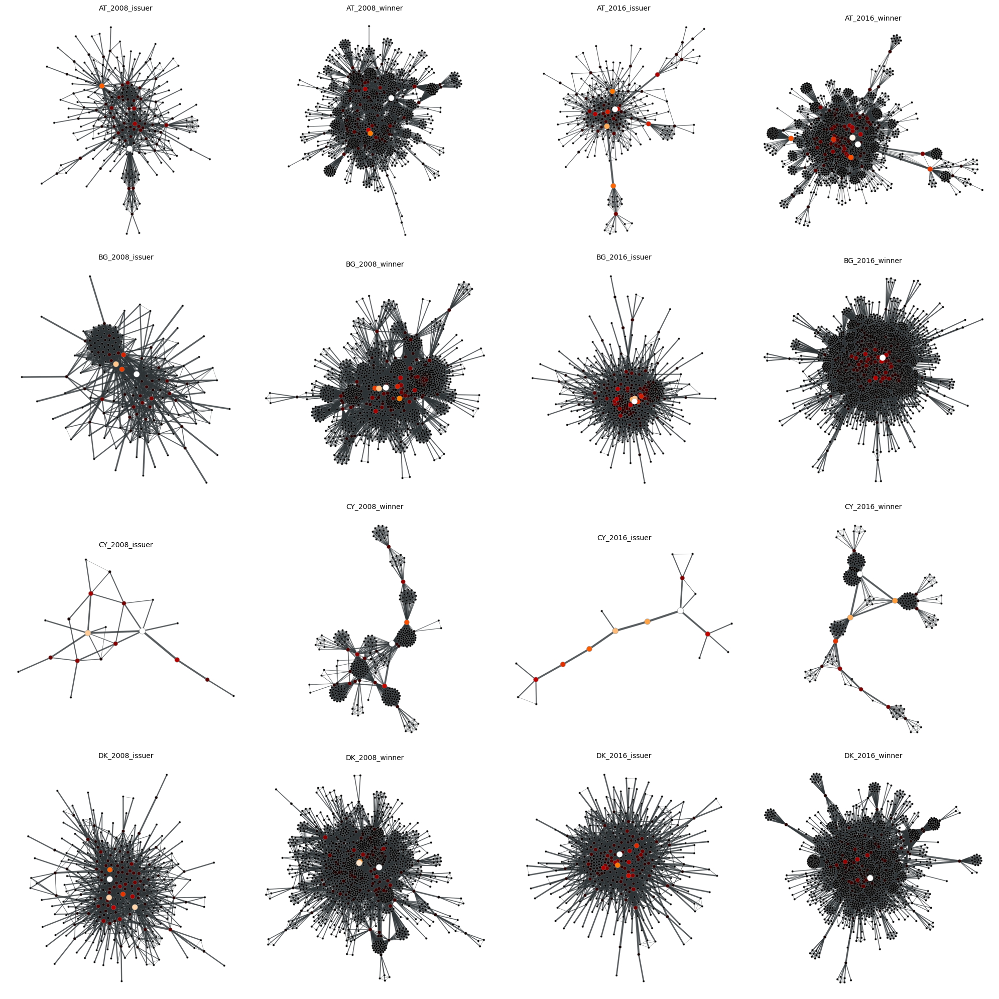

In [37]:
# Get the list of all saved images for betweenness visualizations
image_files_bt_pr = sorted([os.path.join(output_dir_bt_pr, f) for f in os.listdir(output_dir_bt_pr) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_bt_pr) / float(cols)))

# Create the figure with subplots for the betweenness visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for betweenness visualizations and add it to the subplot
for i, image_file in enumerate(image_files_bt_pr):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


### Closeness centrality

In [38]:
# Ensure the output directory exists for the closeness images
output_dir_cl_pr = "closeness_images_prj"
os.makedirs(output_dir_cl_pr, exist_ok=True)

In [39]:
# Compute and visualize closeness for each graph, and save as images
for dataset_key, g in datasets_prj.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u) # we use SFDP layout

    # Calculate closeness centrality
    c = gt.closeness(u)

    # Save the visualization as an image
    output_path = os.path.join(output_dir_cl_pr, f"{dataset_key}.png")
    gt.graph_draw(u, pos=pos, vertex_fill_color=c,
                  vertex_size=gt.prop_to_size(c, mi=5, ma=15),
                  vcmap=cm.gist_heat, vorder=c,
                  output=output_path)

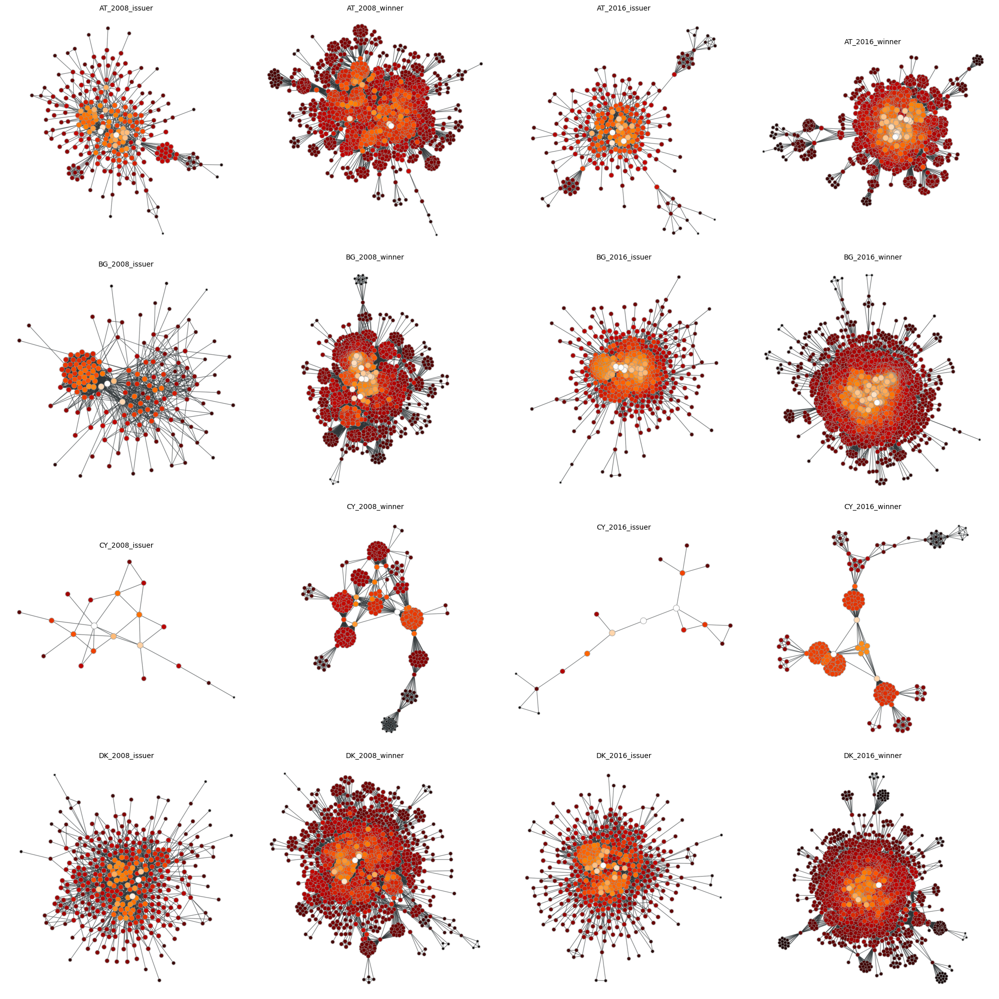

In [40]:
# Get the list of all saved images for closeness visualizations
image_files_cl_pr = sorted([os.path.join(output_dir_cl_pr, f) for f in os.listdir(output_dir_cl_pr) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_cl_pr) / float(cols)))

# Create the figure with subplots for the closeness visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for closeness visualizations and add it to the subplot
for i, image_file in enumerate(image_files_cl_pr):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


## K-core decomposition

The visulatisation of the k-core decomposition of the issuer and winner projections brings to light a number of clusters of nodes that have formed close to the core. There are similarities and differences between countries, projections and years which are described shortly below. <br>

A striking similarity between winner projections across countries and years is the number of small clusters within or close to the core. One suggestive interpretation of this observation is that, the k-core decomposition highlights those winner companies that have contracts with the same issuers. It may be, that within the winner projections which are highlighly connected and centralised across most countries, small clusters emerge around specific issuers. <br>

The most differences again become apparent in the issuer projections. In highly centralised issuer network projections such as Austria and Denmark, we observe the nodes with lower k-cores are at the periphery of the network, and the number of the k-core becomes larger for nodes in the centre of the network. In contrast, in Cyprus where there is little centralisation, we see that the k-core decomposition highlights different clusters. In Bulgaria, which has the above mentioned characteristic of having a pretty strong core, but also a big separate cluster near the core, the k-core decomposition again highlights this big community close to the core.

In [41]:
# Ensure the output directory exists for the stored images
output_dir_kcore_pr = "kcore_images_prj"
os.makedirs(output_dir_kcore_pr, exist_ok=True)

In [42]:
# Generate k-core decomposition images for each graph
for dataset_key, g in datasets_prj.items():
    u = gt.extract_largest_component(g, prune=True)
    kcore = gt.kcore_decomposition(u)
    output_path = os.path.join(output_dir_kcore_pr, f"{dataset_key}.png")
    gt.graph_draw(u, vertex_fill_color=kcore, vertex_text=kcore, output=output_path)

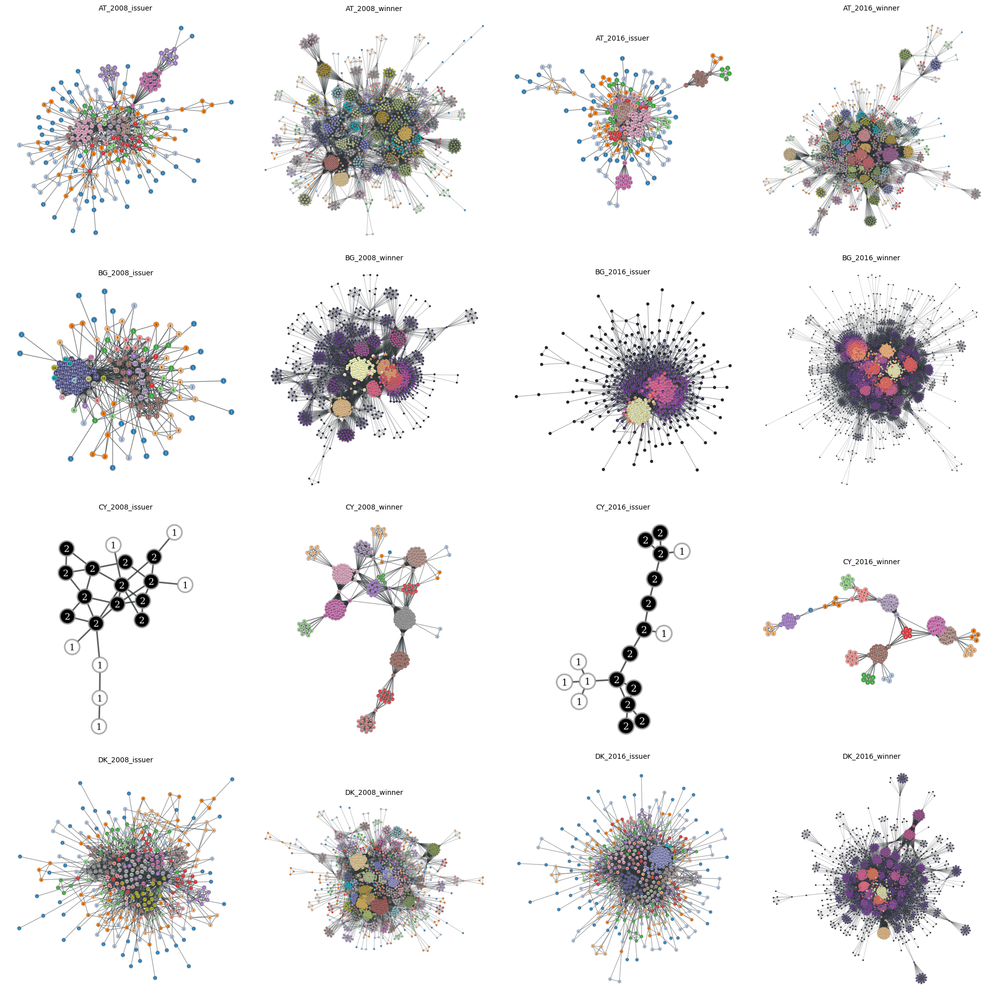

In [43]:
# Get the list of all saved images for the k-core decompositions
image_files_kcore_pr = sorted([os.path.join(output_dir_kcore_pr, f) for f in os.listdir(output_dir_kcore_pr) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_kcore_pr) / float(cols)))

# Create the figure with subplots for the k-core decompositions
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes_flat = axes.flatten()

# Loop through each image file for the k-core decompositions and add it to the subplot
for i, image_file in enumerate(image_files_kcore_pr):
    img = mpimg.imread(image_file)
    axes_flat[i].imshow(img)
    axes_flat[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes_flat[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes_flat)):
    axes_flat[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


## Hierarchy

The below two images show a collection graphs laid out in a tree structure, representing the winner and issuer projections of the EU procurement networks. These graphs are typically used to visualize hierarchical relationships and dependencies.

Across winner and issuer projections, we can observe that winner projections are deeper and more dense suggesting that there are on average more hierachical and that the network projection are on average larger (have more nodes) than the issuer network projections. 

Having a closer look at the issuer projection of Bulgaria and Austria shows that the nodes in the second and third level of the circle are getting more evenly distributed (uniformly distributed) betweem 2008 and 2016, which could suggest that the concentration and highly hiearchical structure of the procurement market in certain sectors expanded into all other sectors too.

### Representation of the hierachy in the issuer and winner projections using Tree layout

In [44]:
# Ensure the output directory exists for the stored positions
output_dir_tree = "tree_layout_prj"
os.makedirs(output_dir_tree, exist_ok=True)

In [45]:
# Assume datasets is a dict with Graph-tool graphs
for dataset_key, g in datasets_prj.items():
    u = gt.extract_largest_component(g, prune=True)
    pos_tree = gt.radial_tree_layout(u, u.vertex(0))
    output_path = os.path.join(output_dir_tree, f"{dataset_key}.png")
    gt.graph_draw(u, pos=pos_tree, output=output_path)

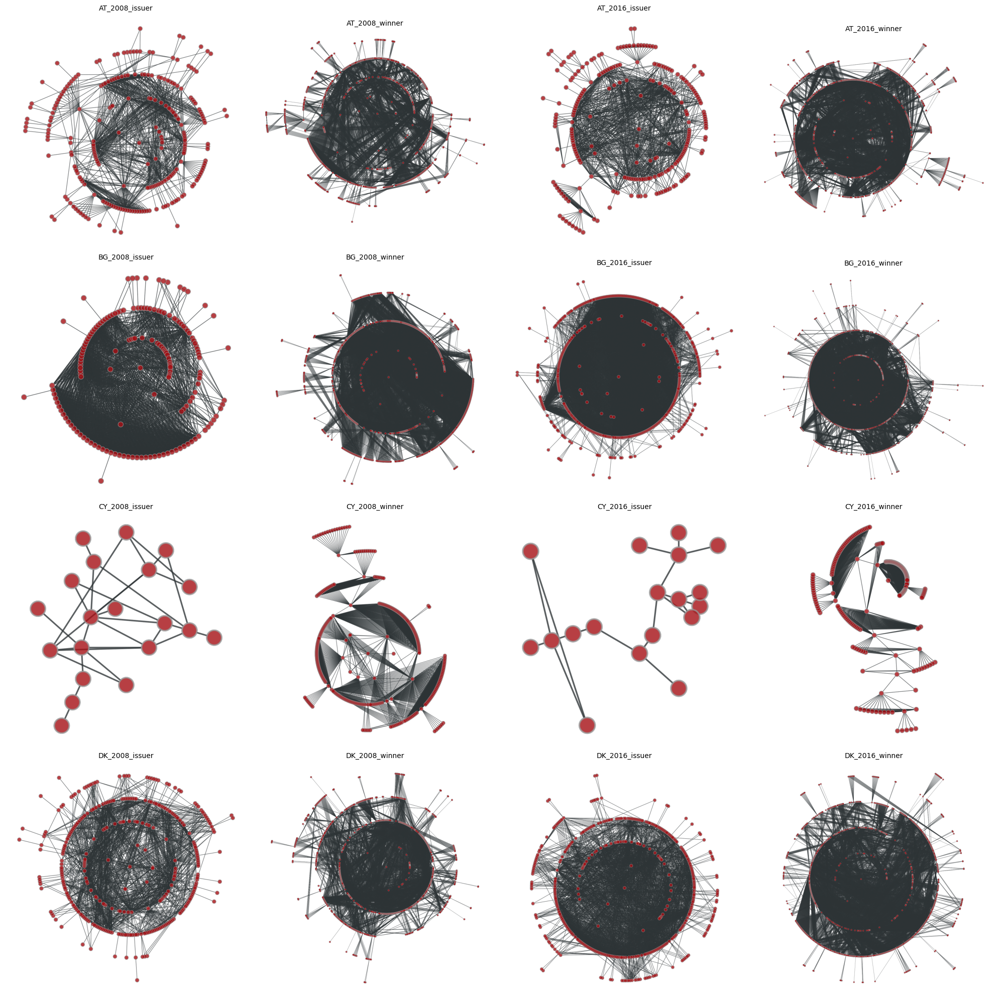

In [46]:
# Get the list of all saved images for the stored positions
image_files_tree = sorted([os.path.join(output_dir_tree, f) for f in os.listdir(output_dir_tree) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_tree) / float(cols)))

# Create the figure with subplots for the stored positions
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for the stored positions and add it to the subplot
for i, image_file in enumerate(image_files_tree):
    # Read each graph from its saved file
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


### Representation of the projections in alternative tree layout with node with highest out-degree in the centre

In [47]:
# Ensure the output directory exists for the stored positions
output_dir_tree_alt = "alt_tree_layout_prj"
os.makedirs(output_dir_tree_alt, exist_ok=True)

In [48]:
# Process each graph to find the vertex with the maximum in-degree
for dataset_key, g in datasets_prj.items():
    u = gt.extract_largest_component(g, prune=True)

    # Find the vertex with the maximum in-degree
    out_degrees = u.get_out_degrees(u.get_vertices())
    maximum = max(out_degrees)
    max_in_degree_vertices = np.where(out_degrees == maximum)[0]

    # Print information about the maximum out-degree
    print(f"Graph: {dataset_key}")
    print("Vertices with the maximum in-degree:", max_in_degree_vertices)
    print("Out-degrees of all vertices:", out_degrees)

    # If there are multiple vertices with the maximum in-degree, choose one
    central_vertex = u.vertex(max_in_degree_vertices[0])

    # Compute the radial tree layout from the central vertex
    pos_tree = gt.radial_tree_layout(u, central_vertex)

    # Save the graph drawing with radial tree layout
    output_path = os.path.join(output_dir_tree_alt, f"{dataset_key}.png")
    gt.graph_draw(u, pos=pos_tree, output=output_path)

Graph: AT_2008_issuer
Vertices with the maximum in-degree: [ 12 158]
Out-degrees of all vertices: [ 9  1  1  3 17  3  9 17  1  4  5  9 47 17  9 17 17 10 17 15  1  1  1  1
  5  1  9 22 17  1  1  2  2  1  9  9 17  9  9  9  4  9 23 17  9  1  1  9
  3 21  1 31 25  6 29  5 10  1  1  2 27 12 21  3  1  3  2  3 10  5 20 28
  9  2  1  6  1 32  3  4 27  2  3 15 32 12  1 13 11  5  8  3  4  1  2 28
  6  2  7 16  1  3 24  1 11 26 24  1  8 26  1  5  8 33  9  2 32 10 15  4
  6  3  1  2 12  7  8  3  4 17  2  9 13 21  1  2  1  3 25 10  2  5  5  2
  2  2  1 17  3  5 14 11 10  5  1  5 17  2 47  2 26  4  3  1  5  4 13 20
  1 13 14 31 36  1 17  5 25  9  3 25  4  2  1  2 18  9  6  2  2  8  1  3
 17  1  2  1 26  5  3  2 21  1 13  4 11  2  1  1 28 23  4  5 15 25  2  2
  4 11  3 21 10  3 13 35  3  1  1  6  1  2 13  1  2  9  4  3  4  3 17  9
 17  1  3  2  5]
Graph: AT_2008_winner
Vertices with the maximum in-degree: [115]
Out-degrees of all vertices: [17 17 47 ...  6  2  2]
Graph: BG_2008_issuer
Vertices with t

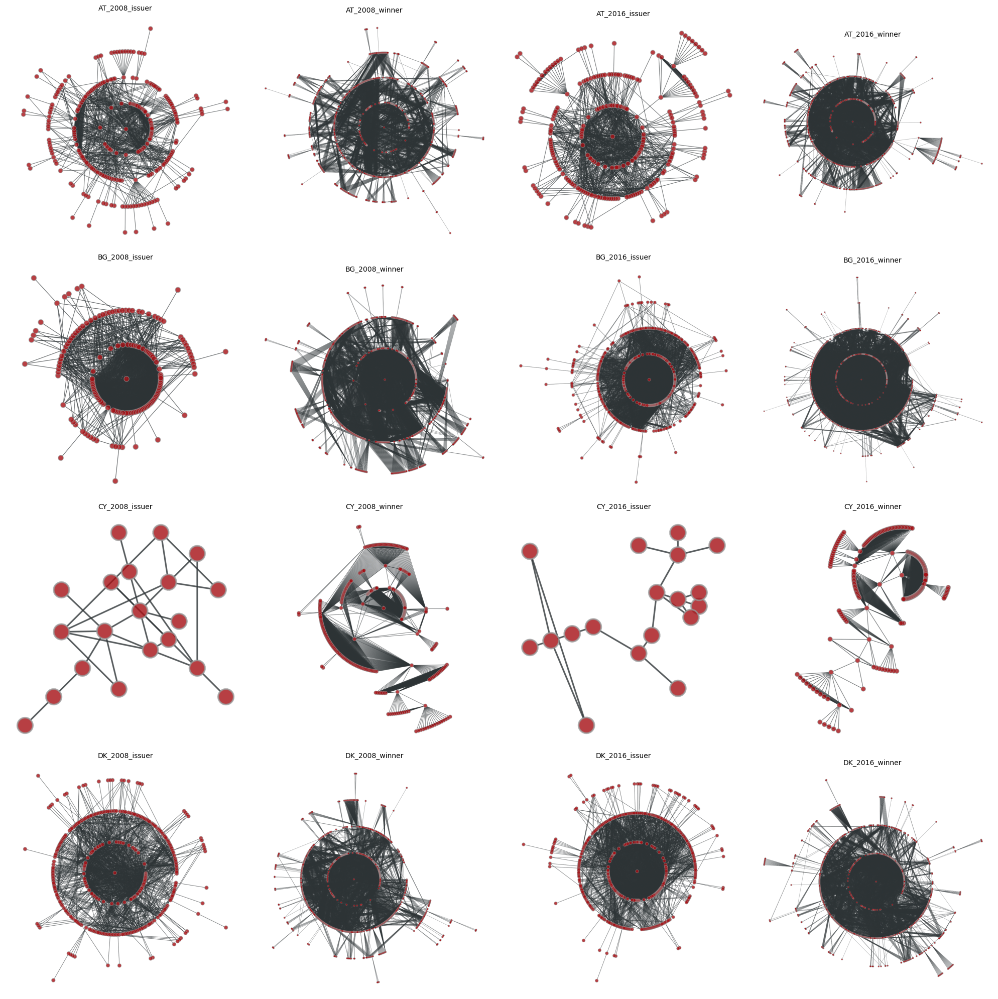

In [49]:
# Get the list of all saved images for the stored positions
image_files_tree_alt = sorted([os.path.join(output_dir_tree_alt, f) for f in os.listdir(output_dir_tree_alt) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_tree_alt) / float(cols)))

# Create the figure with subplots for the stored positions
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for the stored positions and add it to the subplot
for i, image_file in enumerate(image_files_tree_alt):
    # Read each graph from its saved file
    img = plt.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


## Path and distances

Descriptive statistics about the average path lengths, pseudo diameter and the distribution of shortest paths (see the two histograms below) give a more detailed understanding of the issuer and winner network projections. The difference between the first and the second histogram below is that the first histogram plots the distribution of shortest distances, where the shortest distance of every node is calculated with respect to a randomly selected node, in this case the first node in the network. In contrast, the second histogram shows the distributions of shortest path, calculated as the distribution of all shortest pairwise distances. All measures hint towards a rather similar structure across issuer and winner projections. The average shortest distances in the networks are between 1.21 and 2.17, and the pseudo diameters varry between 7 and 9. A look at the histogram suggests that most networks (except for Cyprus) have an unskewed distribution of shortest paths lengths centered around a distance of 2 or 3. The relatively low shortest path length estimated here, suggest that all network projections have small-world properties.

### Distribution of shortest paths of length (from a randomly selected vertex 1)

Graph: AT_2008_issuer
[2 0 4 2 4 4 5 4 5 4 4 5 3 4 3 4 4 3 4 3 5 5 5 4 3 5 3 3 4 5 4 5 6 4 3 5 4
 3 3 5 5 3 4 4 3 4 6 5 4 4 3 4 3 3 3 3 3 5 5 4 3 3 3 4 4 4 4 3 2 3 2 4 3 5
 3 3 5 3 4 4 2 5 4 3 3 3 5 3 4 3 3 3 4 6 5 3 4 4 4 3 5 4 4 5 4 4 3 5 4 4 5
 4 3 3 5 4 2 3 3 3 3 2 5 5 3 3 3 3 3 4 3 4 3 4 4 4 6 4 4 3 3 3 4 4 5 3 4 4
 4 4 3 2 2 3 2 4 4 4 3 5 4 4 4 4 4 4 3 2 4 3 4 4 4 4 4 4 4 5 4 2 4 4 5 4 3
 3 4 5 5 2 4 4 3 3 4 5 4 4 4 5 4 4 4 4 4 4 5 3 3 3 3 4 1 4 4 4 3 5 3 4 3 4
 2 4 5 6 3 4 5 4 3 4 4 3 5 5 5 4 4 3 4 5 4 4 4]
Graph: AT_2008_winner
[1 0 1 ... 3 5 5]
Graph: BG_2008_issuer
[1 0 3 3 3 3 3 3 3 2 3 3 3 3 3 3 2 3 2 2 3 3 3 2 3 4 2 3 3 3 2 3 3 3 2 3 3
 2 3 3 3 3 3 2 3 1 3 3 3 3 3 3 3 3 2 3 2 3 3 2 2 4 1 3 3 3 4 3 2 3 3 3 2 3
 4 2 4 2 2 2 2 3 3 2 1 2 2 3 3 3 3 2 3 3 1 3 3 2 3 3 2 2 2 1 2 3 1 2 2 3 3
 3 2 3 3 2 3 3 3 2 4 1 2 1 2 3 2 3 2 2 3 2 3 2 2 2 3 2 3 3 2 3 1 3 3 3 3 3
 2 2 3 2 3 3 3 2 3 2 2 3 3 3 3 1]
Graph: BG_2008_winner
[1 0 1 ... 4 4 4]
Graph: CY_2008_issuer
[1 0 4 2 2 1 2 2 2 2 2

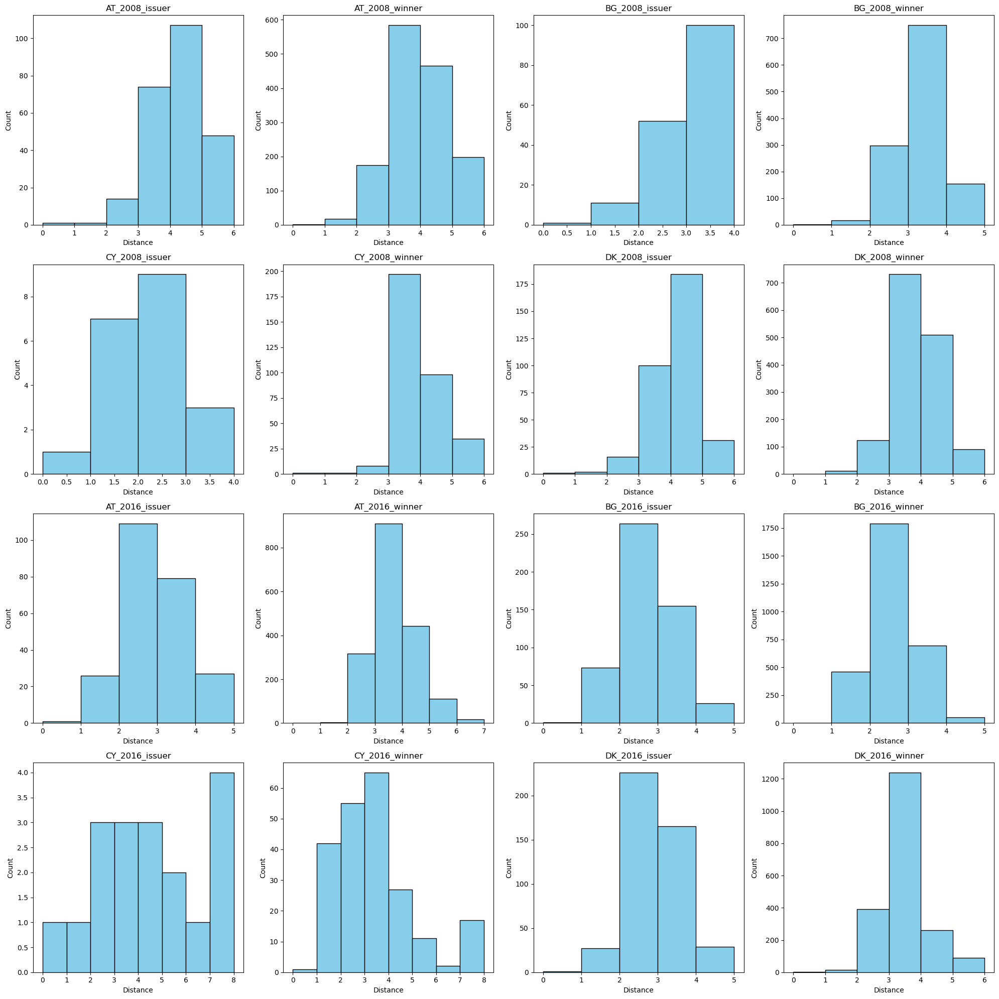

In [100]:
output_dir_path = "output_paths"
os.makedirs(output_dir_path, exist_ok=True)

# Set the number of columns for your faceted histograms
cols = 4
# Calculate the number of rows we will need
rows = int(np.ceil(len(datasets_prj) / cols))

# Create the figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))
# Flatten the axes array for easy iteration
axes_flat = axes.flatten()

# Loop through each graph and calculate shortest distances
for i, (dataset_key, g) in enumerate(datasets_prj.items()):
    u = gt.extract_largest_component(g, prune=True)

    # Calculate shortest distances from vertex 1
    dist = gt.shortest_distance(u, source=u.vertex(1))
    print(f"Graph: {dataset_key}")
    print(dist.a)  # Print the shortest distances for each vertex

    # Plot histogram of distances on the subplot
    ax = axes_flat[i]
    ax.hist(dist.a, bins=range(int(max(dist.a)) + 1), color='skyblue', edgecolor='black')
    ax.set_title(dataset_key)
    ax.set_xlabel('Distance')
    ax.set_ylabel('Count')

# Hide any unused subplots
for j in range(i + 1, len(axes_flat)):
    axes_flat[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


### Distribution of all shortest pairwise distances 

Graph: AT_2008_issuer
[    0.  2242. 10774. 21892. 17458.  6124.  1176.   114.]
Graph: AT_2008_winner
[0.00000e+00 4.25020e+04 3.18598e+05 8.99578e+05 6.22048e+05 1.65730e+05
 1.89640e+04 1.76600e+03 9.60000e+01]
Graph: BG_2008_issuer
[0.0000e+00 3.8580e+03 1.0576e+04 1.0448e+04 1.7660e+03 8.2000e+01
 2.0000e+00]
Graph: BG_2008_winner
[0.00000e+00 6.59580e+04 5.06294e+05 6.99424e+05 1.88194e+05 1.88060e+04
 1.14200e+03 5.40000e+01]
Graph: CY_2008_issuer
[  0.  60. 116. 118.  56.  22.   8.]
Graph: CY_2008_winner
[    0. 13710. 24110. 46336. 18512.  6320.  5632.   640.]
Graph: DK_2008_issuer
[0.0000e+00 3.6400e+03 2.6648e+04 5.2022e+04 2.3808e+04 4.6240e+03
 4.6200e+02 1.8000e+01]
Graph: DK_2008_winner
[0.00000e+00 6.25880e+04 4.82790e+05 9.95998e+05 4.98330e+05 9.94760e+04
 1.33260e+04 1.01800e+03 3.00000e+01]
Graph: AT_2016_issuer
[    0.  2376. 12714. 19730. 13732.  6690.  2464.   576.    40.]
Graph: AT_2016_winner
[0.000000e+00 8.088200e+04 7.321600e+05 1.375176e+06 7.494220e+05
 2.3

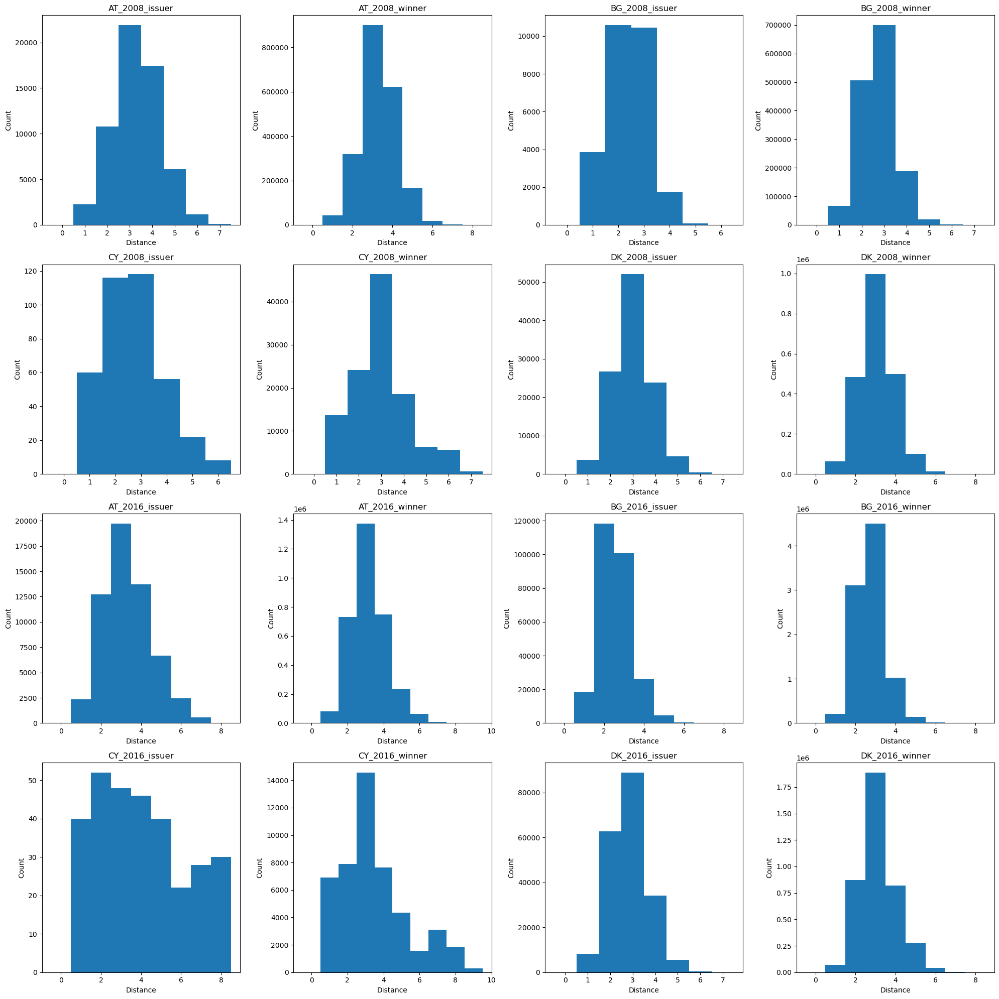

In [50]:
output_dir_path_alt = "output_paths_alt"
os.makedirs(output_dir_path_alt, exist_ok=True)

# Determine the number of rows and columns for the facet grid
cols = 4
rows = int(np.ceil(len(datasets_prj) / cols))

# Create the figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes_flat = axes.flatten()

# Process each graph to calculate and plot the distance histogram
for i, (dataset_key, g) in enumerate(datasets_prj.items()):
    u = gt.extract_largest_component(g, prune=True)

    # Calculate distance histogram using graph_tool
    hist, bin_edges = gt.distance_histogram(u)
    print(f"Graph: {dataset_key}")
    print(hist)  # Print the histogram for each graph

    # Plot the histogram of distances on the subplot
    ax = axes_flat[i]
    ax.bar(bin_edges[:-1], hist, width=1)
    ax.set_title(dataset_key)
    ax.set_xlabel('Distance')
    ax.set_ylabel('Count')

# Hide any unused subplots
for j in range(i + 1, len(axes_flat)):
    axes_flat[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


### Average path length

In [51]:
# Loop through each graph and calculate the average shortest path length
for dataset_key, g in datasets_prj.items():
    u = gt.extract_largest_component(g, prune=True)

    # Calculate shortest distances for all pairs
    dist = gt.shortest_distance(u)

    # Calculate and print the average path length
    average_path_length = gt.vertex_average(u, dist)
    print(f"Graph: {dataset_key}, Average path length: {np.mean(average_path_length)}")


Graph: AT_2008_issuer, Average path length: 1.6765612735922153
Graph: AT_2008_winner, Average path length: 1.6578504502090583
Graph: BG_2008_issuer, Average path length: 1.214558738551334
Graph: BG_2008_winner, Average path length: 1.3704831776705841
Graph: CY_2008_issuer, Average path length: 1.4137128794719505
Graph: CY_2008_winner, Average path length: 1.5218219471834198
Graph: DK_2008_issuer, Average path length: 1.5187638032989375
Graph: DK_2008_winner, Average path length: 1.5398693759707953
Graph: AT_2016_issuer, Average path length: 1.6932065680503916
Graph: AT_2016_winner, Average path length: 1.5939067870263484
Graph: BG_2016_issuer, Average path length: 1.292165933351745
Graph: BG_2016_winner, Average path length: 1.38436207869885
Graph: CY_2016_issuer, Average path length: 2.1683763774701297
Graph: CY_2016_winner, Average path length: 1.7799351860311747
Graph: DK_2016_issuer, Average path length: 1.4327823717162558
Graph: DK_2016_winner, Average path length: 1.5713954271066

### Pseudo-diameter

In [52]:
# Initialize a dictionary to store the pseudo diameters
pseudo_diameters = {}

# Calculate the pseudo diameter for each graph and store the information
for dataset_key, g in datasets_prj.items():
    u = gt.extract_largest_component(g, prune=True)

    # Get the pseudo diameter and the end vertices of the path
    pseudo_diam, end_points = gt.pseudo_diameter(u)

    # Find the shortest path between the end_points, which represents the pseudo diameter
    path = gt.shortest_path(u, source=end_points[0], target=end_points[1])[0]

    # Store the results
    pseudo_diameters[dataset_key] = {
        'pseudo_diameter': pseudo_diam,
        'path_length': len(path),
        'end_points': (int(end_points[0]), int(end_points[1]))
    }

# Display the results in a neatly formatted table
header = f"{'Graph':<20}{'Pseudo Diameter':<20}{'Path Length':<15}{'End Points':<30}"
print(header)
print("-" * len(header))  # Print a separator line

for key, value in pseudo_diameters.items():
    end_points_str = f"({value['end_points'][0]}, {value['end_points'][1]})"
    print(f"{key:<20}{value['pseudo_diameter']:<20}{value['path_length']:<15}{end_points_str:<30}")

Graph               Pseudo Diameter     Path Length    End Points                    
-------------------------------------------------------------------------------------
AT_2008_issuer      7.0                 8              (93, 136)                     
AT_2008_winner      8.0                 9              (867, 387)                    
BG_2008_issuer      6.0                 7              (7, 74)                       
BG_2008_winner      7.0                 8              (1185, 1017)                  
CY_2008_issuer      6.0                 7              (2, 13)                       
CY_2008_winner      7.0                 8              (13, 95)                      
DK_2008_issuer      7.0                 8              (131, 313)                    
DK_2008_winner      8.0                 9              (563, 790)                    
AT_2016_issuer      8.0                 9              (16, 9)                       
AT_2016_winner      9.0                 10            

## Percolation thresholds of the issuer and winner projections of the network

The Percolation Threshold is the point in the process of removing edges from a network at which the size of the largest component dramatically decreases. It represents a critical point beyond which the network loses its large-scale connectivity and breaks down into smaller, disconnected components. We usually determine the percolation threshold empirically, but observing at which stage of node removal the size of the largest components starts decreasing significantly.

In the charts below, we remove edges in two aways to investigate when the percolation threshold is reached:
   - The blue line ("Targeted") shows the size of the largest component as the most "important" edges are removed first (with importance being defined as the product of the degrees of the nodes at each end of the edge).
   - The orange line ("Random") shows the size of the largest component when edges are removed randomly.

The most important insight from these graphs is that both the issuer and winner networks are more vulnerable to targeted edge removal than to random removal, with the exception of Cyprus, which may be do to its small network size. The targeted strategy quickly diminishes the size of the largest component, suggesting that there are specific edges whose removal is particularly detrimental to the network's connectivity. This reflects a network that has critical points of failure.

In all graphs, the percolation threshold is visually identifiable as the point where the blue/red line starts to drop sharply. This threshold is reached sooner (i.e., when more edges are remaining) in the targeted removal scenario than in the random removal scenario, which is consistent with the idea that targeted removal is more effective at breaking down the network's connectivity. This implies that if one were to protect the network against failure or attack, it would be crucial to secure the edges that are being targeted in the targeted percolation strategy.

Some differences between the graphs are worth highlighting: The winner projections seem to be more vulnerable to targeted removal than the issuer projection networks which becomes apparent by the earlier, significant drop in the size of the largest components in the winner projection networks. Another interesting observation is that the winner projection networks seem to have two potential perculation thresholds. As becomes particularily apparent in the winner projection network of Cyprus in 2016, there is a first perculation threshold early on in the targeted removal and one much later. This may be do to the prior observation on the structure of the winner projection networks. As mentioned earlier in the notebook, many winner projection networks are highly centralised, but also have strong clusters within this highly centralised network (most likely around issuers). It may be that the first perculation threshold is reached where the centralised network breaks down and the second threshold is reached where we destroy those highly connected smaller clusters.

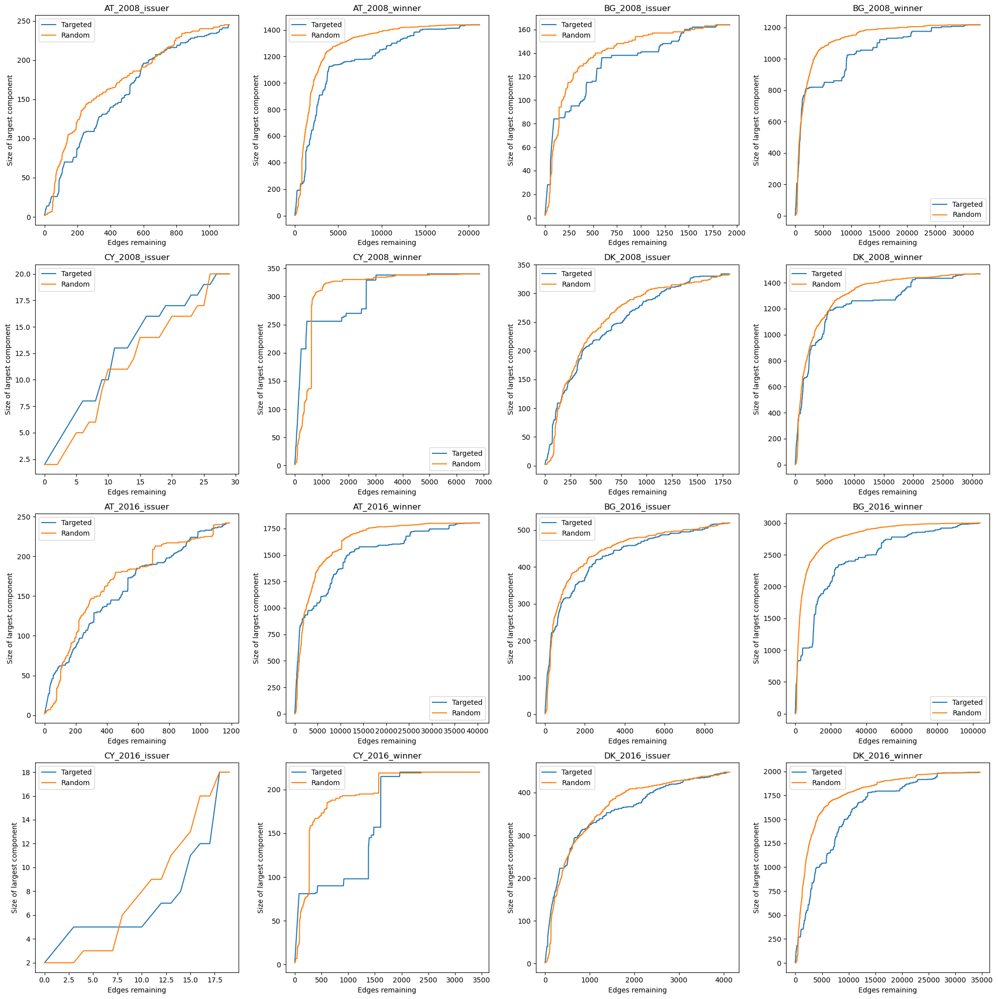

In [8]:
# Determine the number of rows and columns for the facet grid
cols = 4
rows = int(np.ceil(len(datasets_prj) / cols))

# Create the figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes_flat = axes.flatten()

# Process each graph to calculate and plot the edge percolation
for i, (dataset_key, g) in enumerate(datasets_prj.items()):
    u = gt.extract_largest_component(g, prune=True)

    # Calculate edges sorted by the product of their vertex degrees for targeted percolation
    edges = sorted([(e.source(), e.target()) for e in u.edges()],
                   key=lambda e: e[0].in_degree() * e[1].in_degree(), reverse=True)

    # Perform targeted edge percolation
    sizes, comp = gt.edge_percolation(u, edges)

    # Shuffle edges for random percolation
    np.random.shuffle(edges)
    sizes2, comp2 = gt.edge_percolation(u, edges)

    # Plot the results on the subplot
    ax = axes_flat[i]
    ax.plot(sizes, label="Targeted")
    ax.plot(sizes2, label="Random")
    ax.set_title(dataset_key)
    ax.set_xlabel('Edges remaining')
    ax.set_ylabel('Size of largest component')
    ax.legend()

# Hide any unused subplots
for j in range(i + 1, len(axes_flat)):
    axes_flat[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


## Community detection

### Local Clustering Coefficient

The local clustering coefficient is a metric that calculates what proportion of a node's direct contacts are also in contact with each other. It's a measure that ranges from 0, where a node's neighbors are not interconnected, to 1, where all the neighbors are connected. In the networks projection at hand, the average local clustering coefficient consistently exceeds 0.5, except for Cyprus. This indicates that, on average, more than half of the neighboring nodes for any given node are interconnected. This pattern of connectivity is stable across different countries and throughout the years. The coefficient ranges between 0.27 and 0.96.

One noteworthy difference between the winner projections and the issuer projections is that for every issuer-winner pair, the local clustering coefficient is higher for the winner projection than for the issuer projection. This observation indicating a strong tendency for nodes to form cliques or tightly knit communities in the winner projections compared to issuer projections. The finding is not surprising, given the hypothesis that winner clusters form around large issuers that give out many procurement contracts.

In [54]:
# Loop through each graph and calculate the local clustering coefficient
for dataset_key, g in datasets_prj.items():
    u = gt.extract_largest_component(g, prune=True)  # Extract the largest component

    # Calculate local clustering for each vertex in the graph
    clust = gt.local_clustering(u)
    
    # Calculate and print the average local clustering coefficient
    average_clust = gt.vertex_average(u, clust)
    print(f"Graph: {dataset_key}, Local clustering coefficient: {average_clust[0]}")


Graph: AT_2008_issuer, Average clustering coefficient: 0.5482435553695537
Graph: AT_2008_winner, Average clustering coefficient: 0.9138186074666518
Graph: BG_2008_issuer, Average clustering coefficient: 0.6456683079179061
Graph: BG_2008_winner, Average clustering coefficient: 0.9103639444743514
Graph: CY_2008_issuer, Average clustering coefficient: 0.2754761904761905
Graph: CY_2008_winner, Average clustering coefficient: 0.9745897628209349
Graph: DK_2008_issuer, Average clustering coefficient: 0.6169803184103523
Graph: DK_2008_winner, Average clustering coefficient: 0.8945287303119358
Graph: AT_2016_issuer, Average clustering coefficient: 0.595591281981862
Graph: AT_2016_winner, Average clustering coefficient: 0.9229271970800893
Graph: BG_2016_issuer, Average clustering coefficient: 0.6425187450361705
Graph: BG_2016_winner, Average clustering coefficient: 0.8737475127307714
Graph: CY_2016_issuer, Average clustering coefficient: 0.3148148148148148
Graph: CY_2016_winner, Average clusteri

### Degree-clustering plots

The scatterplots show the clustering coefficient of nodes plotted against their degree. Here's what we can infer from each plot.

Issuer projections: <br>
    - There is a high clustering coefficient for nodes with a low out-degree, which suggests these nodes tend to form tight clusters. <br>
    - As the degree k increases, the clustering coefficient decreases, indicating that nodes with more connections are less likely to be part of tightly-knit groups. In some cases it looks like the clustering coefficient is inversely related to the degree k, which provides evidence that the issuer projections are hierchical. <br>
    - The trend also suggests a scale-free-like behavior where there are many small nodes with high clustering, and the hubs (nodes with a high out-degree) have lower clustering.<br>
    - There is also suggestive evidence that the network is disassortative, given one could think that the high degree nodes have a low clustering coefficient because they are connecting with more sparsely connected nodes. But further investigation would be necessary to add evidence to this hypothesis.<br>

Winner projections:<br>
    - Similar to the issuer scatterplot, nodes with a lower out-degree have higher clustering coefficients, indicating tight-knit communities among these nodes.<br>
    - The decrease in the clustering coefficient as degree k increases is more pronounced and consistent in this scatterplot, reinforcing both the hierarchical and scale-free network structure.<br>
    - Nodes with a high out-degree (hubs) show a significant drop in their clustering coefficient, which suggests these hubs might be connecting different parts of the network together rather than forming clusters themselves.<br>

For both scatterplots, these observations align with the scale-free network properties and the small-world phenomenon to some extent, as many nodes have a high clustering coefficient, indicating potential local community structures. However, as the degree increases, the declining clustering coefficient points to the presence of hub nodes that are less embedded in cliques and more likely to be connecting diverse parts of the network.

Overall, these scatterplots suggest that in both the issuer and winner networks, there are likely to be many small clusters or communities, especially among nodes with fewer connections, but the key connectors or hubs tend to not participate as much in such tight-knit groups, possibly acting as bridges in the overall network structure.

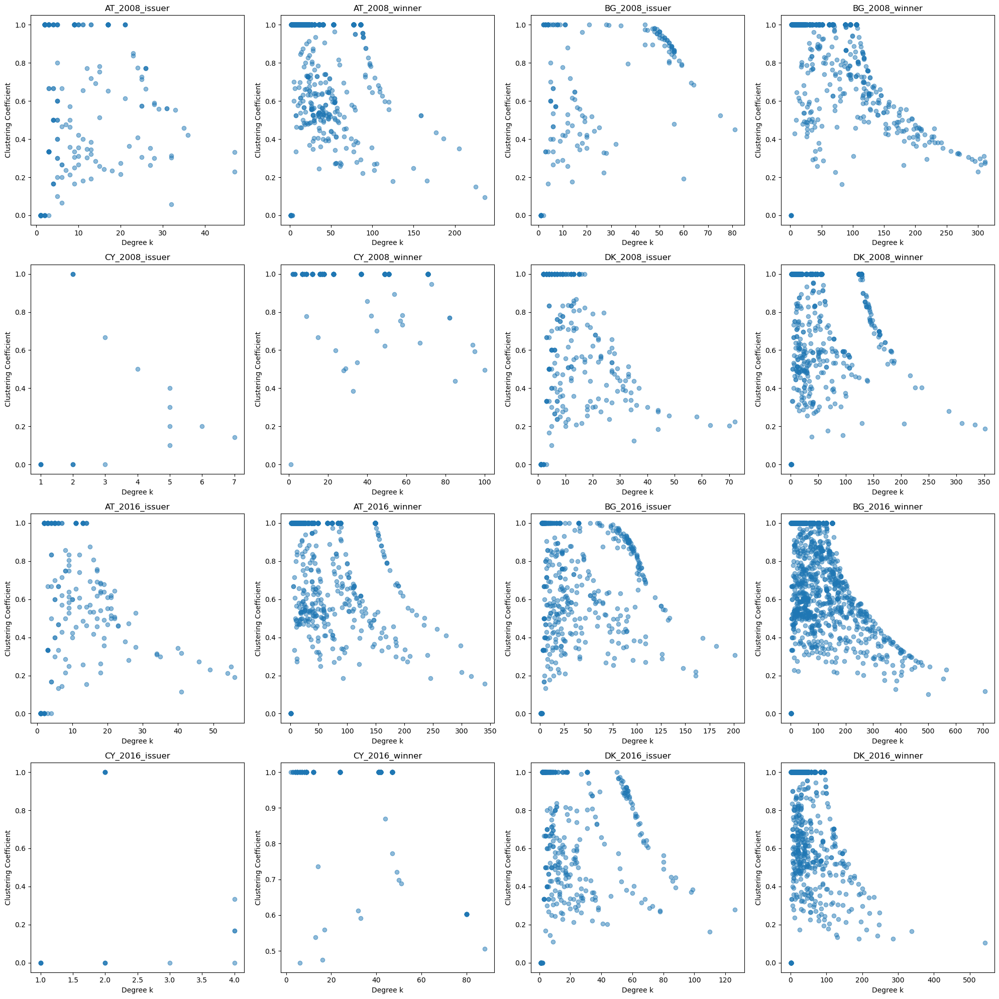

In [13]:
# Determine the number of rows needed for the faceted plots
cols = 4
rows = int(np.ceil(len(datasets_prj) / cols))

# Create the figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))
axes_flat = axes.flatten()

# Iterate over each graph and plot out-degrees vs clustering
for i, (dataset_key, g) in enumerate(datasets_prj.items()):
    # Extract the largest component
    u = gt.extract_largest_component(g, prune=True)

    # Calculate local clustering for each vertex in the graph
    clust = gt.local_clustering(u)

    # Get out-degrees of all vertices
    out_degs = u.get_out_degrees(u.get_vertices())

    # Select the subplot to plot on
    ax = axes_flat[i]
    
    # Create the scatter plot
    ax.scatter(out_degs, clust.a, alpha=0.5)

    # Set the title and labels
    ax.set_title(dataset_key)
    ax.set_xlabel('Degree k')
    ax.set_ylabel('Clustering Coefficient')

# Hide any unused subplots
for j in range(i + 1, len(axes_flat)):
    axes_flat[j].axis('off')

# Adjust layout and display the plots
plt.tight_layout()
plt.show()


### Blockmodel decomposition

Blockmodel decomposition is an approach to group nodes into blocks based on their connectivity pattern. Mathematically speaking the clusters in the network are formed such that they maximize the posterior distribution of the partioning, given the network. The blockmodel decompositions below confirm some aspects of the network structure that were inferred from the local clustering coefficient and degree-clustering plots.


Issuer projections: Most of the projections have a dense core with several densely connected nodes (potentially high-degree nodes) surrounded by sparser peripheries. This could correspond to the previous analysis where the nodes with lower degrees had high clustering coefficients, indicative of tight-knit communities. The dense core could be a group of nodes with many interconnections, possibly corresponding to the high average clustering coefficient observed. The detected communities highlighte by different colours shows signs of community structure but with a potentially more interconnected core, which could be indicative of a different type of organizational structure within the network.

Winner projections: Generally, the projections appears to have a less dense core compared to the issuer projections, with more nodes on the periphery that are not as densely connected. This aligns with the higher average clustering coefficient observed, suggesting that while there may be a large number of nodes with high clustering, the core itself is not as tightly connected as the issuer network. The spread of nodes also supports the idea of disassortative mixing, where higher-degree nodes might be serving as bridges between different clusters. As highlighted through the colouring of the detected communities, the blockmodel decompositon suggests a strong presence of community structures with some central nodes potentially acting as hubs or connectors.

Overall, the blockmodels support the analysis so far in the sense that they provide a visual confirmation of the presence of community structures and showing that the issuer projections have a dense core with surrounding communities.

### Blockmodel decomposition of network projections in spring / FDP (Scalable Force Directed Placement) layout

In [56]:
# Ensure the output directory exists for the blockmodel images
output_dir_bm = "blockmodel_images"
os.makedirs(output_dir_bm, exist_ok=True)

In [57]:
# Compute and visualize the blockmodel for each graph, and save as images
for dataset_key, g in datasets_prj.items():
    # Extract the largest component
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u)
    # Minimize the blockmodel description length
    state = gt.minimize_blockmodel_dl(u)
    # Save the visualization as an image
    output_path = os.path.join(output_dir_bm, f"{dataset_key}.png")
    state.draw(pos=pos, vertex_shape=state.get_blocks(), output=output_path)

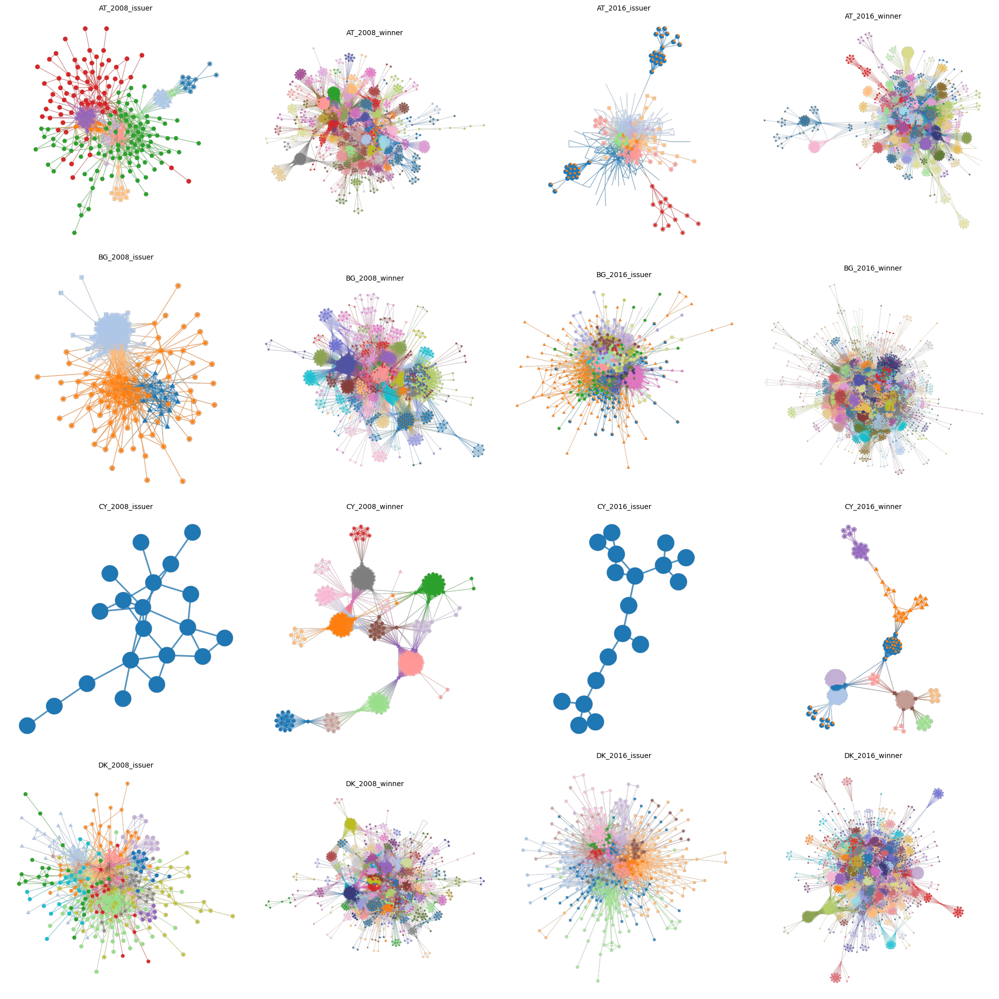

In [58]:
# Get the list of all saved images for blockmodel visualizations
image_files_bm = sorted([os.path.join(output_dir_bm, f) for f in os.listdir(output_dir_bm) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_bm) / float(cols)))

# Create the figure with subplots for the blockmodel visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for blockmodel visualizations and add it to the subplot
for i, image_file in enumerate(image_files_bm):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


### Blockmodel decomposition of network projections in Fruchtermann-Reingold layout

In [59]:
# Ensure the output directory exists for the blockmodel images
output_dir_bm_fr = "blockmodel_fr_images"
os.makedirs(output_dir_bm_fr, exist_ok=True)

In [60]:
# Compute and visualize the blockmodel for each graph, and save as images
for dataset_key, g in datasets_prj.items():
    # Extract the largest component
    u = gt.extract_largest_component(g, prune=True)

    # Compute the Fruchterman-Reingold layout for u
    pos_fr = gt.fruchterman_reingold_layout(u, n_iter=100)  # You can adjust the iterations if needed

    # Minimize the blockmodel description length
    state = gt.minimize_blockmodel_dl(u)

    # Save the visualization as an image
    output_path = os.path.join(output_dir_bm_fr, f"{dataset_key}.png")
    state.draw(pos=pos_fr, vertex_shape=state.get_blocks(), output=output_path)

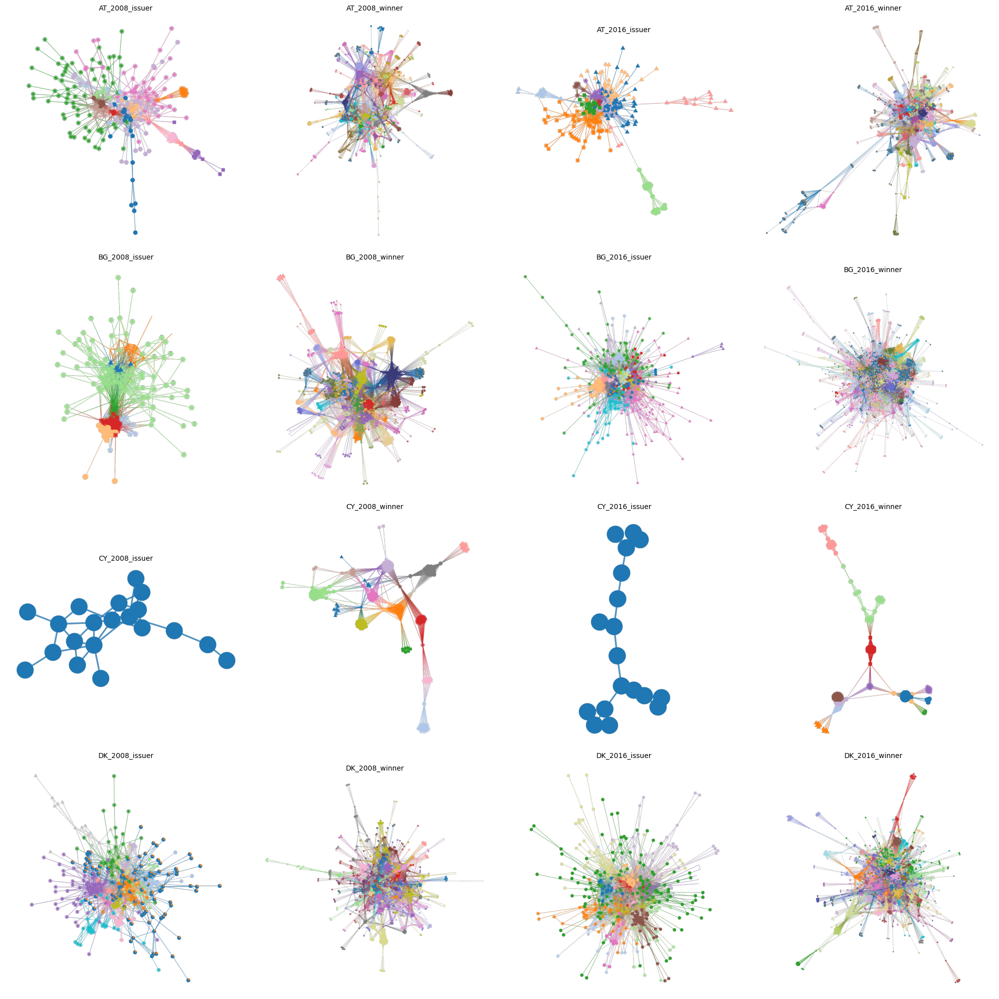

In [61]:
# Get the list of all saved images for blockmodel visualizations
image_files_bm_fr = sorted([os.path.join(output_dir_bm_fr, f) for f in os.listdir(output_dir_bm_fr) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_bm_fr) / float(cols)))

# Create the figure with subplots for the blockmodel visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for blockmodel visualizations and add it to the subplot
for i, image_file in enumerate(image_files_bm_fr):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


### Nested blockmodel as chord diagram

The visualizations below present nested blockmodel decomposition in form of so called chord diagrams. Across all chord diagrams we observe:

Interconnectivity: The diagrams show the complexity and density of interconnections between nodes. A large number of arcs connecting different segments of the circle indicates a high level of interconnectivity within the network.

Community Structure: In both diagrams, we can see clusters of nodes that are more tightly interconnected with each other than with the rest of the network. These clusters can be identified by groups of arcs that are more densely packed together, often of the same color, indicating a community or modular structure within the network.

Centrality and Hubs: Nodes that have a larger number of thicker arcs connected to them may be acting as hubs or central nodes within the network. These hubs play a critical role in maintaining the connectivity of the network.

The chord diagrams provide a different perspective compared to the blockmodels but they still convey similar structural information about the network. The diagrams of the issuer projections shows a variety of thick connections, suggesting several nodes act as significant connectors or hubs within the network, which aligns with the previous analysis of a dense core. The diagrams of the winner projections also displays thick connections but appears to have more variation in connection thickness, which could suggest a more pronounced hierarchical structure with a few very highly connected hubs, as indicated by the high clustering coefficients and potential disassortative mixing.

Overall, the chord diagrams further support the analysis of both projections, illustrating the complex web of relationships and the presence of hubs and communities within the networks. They visually confirm the existence of dense interconnections and suggest the presence of critical nodes that could be influential in the network's structure and dynamics.

In [62]:
# Ensure the output directory exists for the nested blockmodel images
output_dir_nbm = "nested_blockmodel_images"
os.makedirs(output_dir_nbm, exist_ok=True)

In [63]:
# Compute and visualize the nested blockmodel for each graph, and save as images
for dataset_key, g in datasets_prj.items():
    # Extract the largest component
    u = gt.extract_largest_component(g, prune=True)

    # Compute the nested blockmodel
    state2 = gt.minimize_nested_blockmodel_dl(u)

    # Save the visualization as an image
    output_path = os.path.join(output_dir_nbm, f"{dataset_key}.png")
    state2.draw(output=output_path)  # Draw and save the visualization


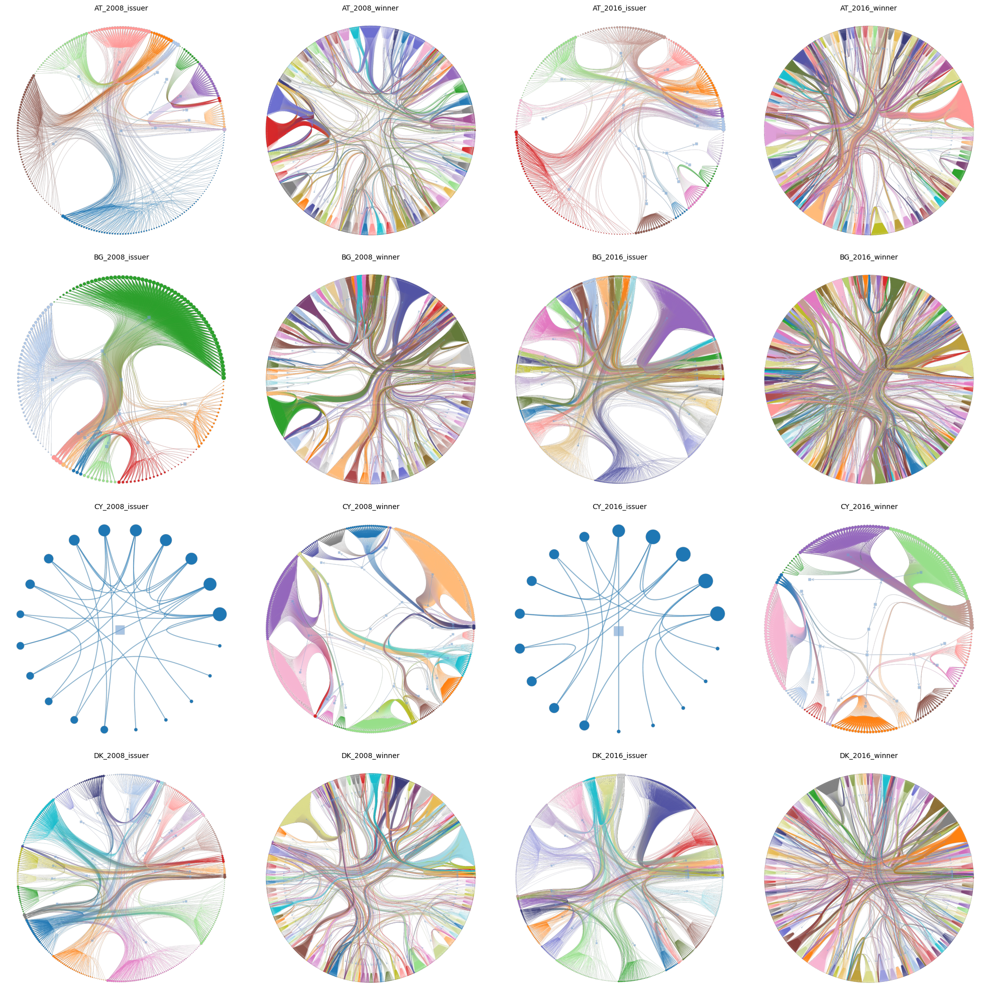

In [64]:
# Get the list of all saved images for nested blockmodel visualizations
image_files_nbm = sorted([os.path.join(output_dir_nbm, f) for f in os.listdir(output_dir_nbm) if f.endswith('.png')])

# Calculate the number of rows and columns for the facet wrap
cols = 4
rows = int(np.ceil(len(image_files_nbm) / float(cols)))

# Create the figure with subplots for the nested blockmodel visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for nested blockmodel visualizations and add it to the subplot
for i, image_file in enumerate(image_files_nbm):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()
